In [ ]:
import os
import json
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import warnings
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib.ticker as ticker
import statsmodels.api as sm
from statsmodels.stats.multitest import multipletests
from scipy.stats import pearsonr

import sys 
sys.path.append(r'..\utils') 
from utils import add_swc_paths, get_seaad_colors, get_tx_order, format_box_plot, AVERAGE_DISTANCE_BETWEEN_NODES


Params

In [ ]:

#HANN mapping
class_col = 'class_label_Hierarchical'
subclass_col = 'subclass_label_Hierarchical'
cluster_col = 'cluster_label_Hierarchical'

morpho_feature_type = 'dendrite' #dendrite, axon, both 


In [4]:
#Load cell data
morpho_data_root = r'\\allen\programs\celltypes\workgroups\mousecelltypes\SarahWB\datasets\human_exc\data\Features\{}'.format(morpho_feature_type)
out_dir = r'\\allen\programs\celltypes\workgroups\mousecelltypes\SarahWB\datasets\human_exc\analysis\20251010_seaad\ME_scatter\{}'.format(morpho_feature_type)
os.makedirs(out_dir, exist_ok=True)

ephys_data_path = r'\\allen\programs\celltypes\workgroups\mousecelltypes\SarahWB\datasets\human_exc\data\ephys\20251008\20251008_ephys_features.csv'

metadata = pd.read_csv(os.path.join(morpho_data_root, 'metadata.csv'))
metadata = metadata.rename(columns={'cell_id' : 'specimen_id'})
metadata = metadata.set_index('specimen_id')
metadata[subclass_col] = metadata[cluster_col].apply(lambda x: x.rsplit('_', 1)[0] if isinstance(x, str) else np.nan)

m_features_filled = pd.read_csv(os.path.join(morpho_data_root, 'RawFeatureWide.csv'), index_col='specimen_id')
m_features = m_features_filled.columns.tolist()

e_features_raw = pd.read_csv(ephys_data_path, index_col='specimen_id')
e_features_raw[subclass_col] = e_features_raw[subclass_col].replace('L5 ET_ME', 'L5 ET').replace('L5 ET(ME)', 'L5 ET')
e_meta_cols = ['specimen_id', 'specimen_name', 'subclass_label_Hierarchical', 'depth_from_pia_norm', 'ephys', 'feature_count']
e_nwg_cols = [c for c in e_features_raw.columns if c.startswith('nwg_')] #nathan features for FI curve plot (don't impute, don't use in eta2)
e_features = [c for c in e_features_raw.columns if not c in (e_meta_cols+e_nwg_cols)] #ephys features to impute (impute, use in eta2)

features = m_features_filled.merge(e_features_raw[e_features], how='inner', left_index=True, right_index=True)
features = features.merge(metadata, how='inner', left_index=True, right_index=True)
features['apical_basal_total_length'] = features['apical_dendrite_total_length'] + features['basal_dendrite_total_length']

#for the feature x depth plots, we can use the full M and E datasets independently, don't need the inner join 
full_metadata = pd.read_csv(r'\\allen\programs\celltypes\workgroups\mousecelltypes\SarahWB\datasets\human_exc\data\metadata\20251008\Datalock_Human_Glut_4_4_25(patchseq_mapping_results).csv', encoding='latin1')
full_metadata = full_metadata[~full_metadata['cell_id'].isna()]
full_metadata.set_index('cell_id', inplace=True)
full_metadata[cluster_col] = full_metadata[cluster_col].replace('L5 ET_ME', 'L5 ET(ME)')
m_data = m_features_filled.merge(full_metadata[[subclass_col, cluster_col, 'depth_from_pia_norm']], left_index=True, right_index=True)
e_data = e_features_raw.merge(full_metadata[[cluster_col]], left_index=True, right_index=True)

m_data = m_data[~m_data.depth_from_pia_norm.isna()]
e_data = e_data[~e_data.depth_from_pia_norm.isna()]

with open(r"\\allen\programs\celltypes\workgroups\mousecelltypes\SarahWB\datasets\human_exc\data\formatting_dicts\ttype_layer_dict.json", "r") as f:
    ttype_to_layer_dict = json.load(f)

m_data['layer'] = m_data[cluster_col].map(lambda x: ttype_to_layer_dict[x])
e_data['layer'] = e_data[cluster_col].map(lambda x: ttype_to_layer_dict[x])



In [5]:
color_dict = get_seaad_colors()

with open(r'\\allen\programs\celltypes\workgroups\mousecelltypes\SarahWB\datasets\human_exc\data\colors\layer_colors.json') as f:
    layer_color_dict = json.load(f)


#Get custom transcriptomic order
ttype_order, subclass_order = get_tx_order()
group_order = {
    'subclass_label' : subclass_order,
    't_type' :  ttype_order, 
    'layer' : sorted(e_data.layer.unique())
}

compartment_column = {
    'apical' : 'apical_dendrite_total_length',
    'basal' : 'basal_dendrite_total_length',
    'neurite' : 'apical_basal_total_length'
}

tx_labels = {
    'subclass_label' : 'subclass',
    't_type' : 'ttype',
    'layer' : 'layer'
}

tx_column = {
    'subclass_label' : subclass_col,
    't_type' : cluster_col,
    'layer' : 'layer'
}

# Ephys features x morpho lengths

In [10]:
for tx_col, tx_name in tx_labels.items():
    for comp, comp_column in compartment_column.items():

        fig_path = os.path.join(out_dir, f'human_excitatory_{tx_name}_{comp}_length_vs_ephys_features_scatter.pdf')
        with PdfPages(fig_path) as pdf:
            with warnings.catch_warnings():
                warnings.simplefilter(action='ignore', category=FutureWarning)

                for e_feat in e_features:

                    fig = plt.figure(figsize=(6, 4))

                    # Remove rows with NaN or inf in either x or y
                    valid_mask = np.isfinite(features[comp_column]) & np.isfinite(features[e_feat])
                    x = features.loc[valid_mask, comp_column]
                    y = features.loc[valid_mask, e_feat]
                    hue = features.loc[valid_mask, cluster_col]

                    # Scatter plot
                    sns.scatterplot(x=x, y=y, hue=hue, hue_order=group_order[tx_col], palette=color_dict, zorder=2)
                    plt.xlabel(comp_column.replace('_', ' ') + ' (µm)', fontsize=20)
                    plt.ylabel(e_feat.replace('_', ' '), fontsize=20)
                    plt.xticks(fontsize=16)
                    plt.yticks(fontsize=16)
                    ax = plt.gca()
                    ax.xaxis.set_major_locator(ticker.MaxNLocator(4))

                    # Fit linear regression line if enough points
                    if len(x) > 1:
                        m, b = np.polyfit(x, y, 1)
                        plt.plot(x, m * x + b, color='grey', zorder=1)

                        # Calculate correlation coefficient
                        corr, p_value = pearsonr(x, y)
                        alpha = 0.05
                        if p_value < alpha:
                            p_val_exp = int(np.floor(np.log10(p_value)))  # exponent
                            p_val_mant = p_value / 10 ** p_val_exp  # mantissa
                            plt.text(
                                0.5, 1.2,
                                f'Correlation coefficient (r): {corr:.2f}\nP-value: {p_val_mant:.2f}e{p_val_exp} *',
                                horizontalalignment='center',
                                verticalalignment='center',
                                transform=ax.transAxes,
                                color='blue',
                                fontsize=20
                            )
                        else:
                            plt.text(
                                0.5, 1.2,
                                f'Correlation coefficient (r): {corr:.2f}\nP-value: {p_value:.2f}',
                                horizontalalignment='center',
                                verticalalignment='center',
                                transform=ax.transAxes,
                                fontsize=20
                            )

                    plt.gca().spines['top'].set_visible(False)
                    plt.gca().spines['right'].set_visible(False)
                    plt.legend(loc='center left', bbox_to_anchor=(1.2, 0.5), fontsize=12)

                    pdf.savefig(fig, bbox_inches='tight')
                    plt.close(fig)


In this code, pearsonr calculates the Pearson correlation coefficient (corr). You can print it to see the value. It ranges from -1 to 1, where:

- r=1 indicates a perfect positive linear relationship.
- r=−1 indicates a perfect negative linear relationship.
- r=0 indicates no linear relationship.

CC and pvals per ttype

In [11]:
for tx_col, tx_name in tx_labels.items():
    for comp, comp_column in compartment_column.items():
        
        fig_path = os.path.join(
            out_dir, 
            f'human_excitatory_{tx_name}_{comp}_length_vs_ephys_features_scatter_{tx_name}Stats_with{tx_name}LR.pdf'
        )
        
        with PdfPages(fig_path) as pdf:
            with warnings.catch_warnings():
                warnings.simplefilter(action='ignore', category=FutureWarning)

                for e_feat in e_features:

                    fig = plt.figure(figsize=(6, 4))

                    plt.xlabel(comp_column.replace('_', ' ') + ' (µm)', fontsize=20)
                    plt.ylabel(e_feat.replace('_', ' '), fontsize=20)
                    plt.xticks(fontsize=16)
                    plt.yticks(fontsize=16)
                    ax = plt.gca()
                    ax.xaxis.set_major_locator(ticker.MaxNLocator(4))

                    # T-type stats:
                    ttype_legends = []
                    ttype_scatters = []

                    for group in group_order[tx_col]:

                        cluster_data = features[features[tx_column[tx_col]] == group]
                        # Remove NaNs/Infs
                        valid_mask = np.isfinite(cluster_data[comp_column]) & np.isfinite(cluster_data[e_feat])
                        cluster_data_clean = cluster_data.loc[valid_mask]

                        scat = sns.scatterplot(
                            data=cluster_data_clean, x=comp_column, y=e_feat, hue=cluster_col, 
                            hue_order=group_order[tx_col], palette=color_dict, zorder=2
                        )
                        ttype_scatters.append(scat)
                        this_ttype_legend = f'{group} (n={len(cluster_data_clean)})'

                        if len(cluster_data_clean) > 1: 
                            # Calculate correlation coefficient
                            corr, p_value = pearsonr(cluster_data_clean[comp_column], cluster_data_clean[e_feat])
                            alpha = 0.05

                            if p_value < alpha:
                                p_val_exp = int(np.floor(np.log10(p_value)))
                                p_val_mant = p_value / 10**p_val_exp
                                this_ttype_legend += f', r={corr:.2f}, p={p_val_mant:.2f}e{p_val_exp} *'

                                # Fit linear regression for this group
                                m, b = np.polyfit(cluster_data_clean[comp_column], cluster_data_clean[e_feat], 1)
                                plt.plot(
                                    cluster_data_clean[comp_column], m * cluster_data_clean[comp_column] + b, 
                                    color=color_dict[group], zorder=1
                                )
                            else:
                                this_ttype_legend += f', r={corr:.2f}, p={p_value:.2f}'

                        ttype_legends.append(this_ttype_legend)

                    plt.gca().spines['top'].set_visible(False)
                    plt.gca().spines['right'].set_visible(False)
                    plt.legend(
                        scat.get_legend_handles_labels()[0], ttype_legends, 
                        loc='center left', bbox_to_anchor=(1.2, 0.5), fontsize=12
                    )

                    # Full data stats: remove NaNs/Infs
                    valid_mask_all = np.isfinite(features[comp_column]) & np.isfinite(features[e_feat])
                    x_all = features.loc[valid_mask_all, comp_column]
                    y_all = features.loc[valid_mask_all, e_feat]

                    if len(x_all) > 1:
                        corr, p_value = pearsonr(x_all, y_all)
                        alpha = 0.05
                        if p_value < alpha:
                            p_val_exp = int(np.floor(np.log10(p_value)))
                            p_val_mant = p_value / 10**p_val_exp
                            plt.text(
                                0.5, 1.2,
                                f'Correlation coefficient (r): {corr:.2f}\nP-value: {p_val_mant:.2f}e{p_val_exp} *',
                                horizontalalignment='center', verticalalignment='center',
                                transform=ax.transAxes, color='blue', fontsize=20
                            )
                        else:
                            plt.text(
                                0.5, 1.2,
                                f'Correlation coefficient (r): {corr:.2f}\nP-value: {p_value:.2f}',
                                horizontalalignment='center', verticalalignment='center',
                                transform=ax.transAxes, fontsize=20
                            )

                        # Fit regression for all data
                        m, b = np.polyfit(x_all, y_all, 1)
                        plt.plot(x_all, m * x_all + b, color='grey', zorder=1)

                    pdf.savefig(fig, bbox_inches='tight')
                    plt.close(fig)


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_14480\302156710.py:35: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  scat = sns.scatterplot(
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_14480\302156710.py:35: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  scat = sns.scatterplot(
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_14480\302156710.py:35: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  scat = sns.scatterplot(
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_14480\302156710.py:35: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  scat = sns.scatterplot(
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_14480\302156710.py:35: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  scat = sns.scatterplot(
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_14480\302156710.py:35: UserWarning

In [12]:
for tx_col, tx_name in tx_labels.items():
    for comp, comp_column in compartment_column.items():

        fig_path = os.path.join(
            out_dir, 
            f'human_excitatory_{tx_name}_{comp}_length_vs_ephys_features_scatter_{tx_name}Stats.pdf'
        )
        with PdfPages(fig_path) as pdf:
            with warnings.catch_warnings():
                warnings.simplefilter(action='ignore', category=FutureWarning)

                for e_feat in e_features:

                    fig = plt.figure(figsize=(6, 4))

                    plt.xlabel(comp_column.replace('_',' ') + ' (µm)', fontsize=20)
                    plt.ylabel(e_feat.replace('_',' '), fontsize=20)
                    plt.xticks(fontsize=16)
                    plt.yticks(fontsize=16)
                    ax = plt.gca()
                    ax.xaxis.set_major_locator(ticker.MaxNLocator(4))

                    # T-type stats:
                    ttype_legends = []
                    ttype_scatters = []

                    for group in group_order[tx_col]:

                        cluster_data = features[features[tx_column[tx_col]] == group]
                        # Remove NaNs/Infs
                        valid_mask = np.isfinite(cluster_data[comp_column]) & np.isfinite(cluster_data[e_feat])
                        cluster_data_clean = cluster_data.loc[valid_mask]

                        scat = sns.scatterplot(
                            data=cluster_data_clean,
                            x=comp_column,
                            y=e_feat,
                            hue=cluster_col,
                            hue_order=group_order[tx_col],
                            palette=color_dict,
                            zorder=2
                        )
                        ttype_scatters.append(scat)
                        this_ttype_legend = f'{group} (n={len(cluster_data_clean)})'

                        if len(cluster_data_clean) > 1:
                            # Calculate correlation coefficient
                            corr, p_value = pearsonr(cluster_data_clean[comp_column], cluster_data_clean[e_feat])
                            alpha = 0.05

                            if p_value < alpha:
                                p_val_exp = int(np.floor(np.log10(p_value)))  # exponent
                                p_val_mant = p_value / 10**p_val_exp       # mantissa
                                this_ttype_legend += f', r={corr:.2f}, p={p_val_mant:.2f}e{p_val_exp} *'
                            else:
                                this_ttype_legend += f', r={corr:.2f}, p={p_value:.2f}'

                        ttype_legends.append(this_ttype_legend)

                    plt.gca().spines['top'].set_visible(False)
                    plt.gca().spines['right'].set_visible(False)
                    plt.legend(
                        scat.get_legend_handles_labels()[0],
                        ttype_legends,
                        loc='center left',
                        bbox_to_anchor=(1.2, 0.5),
                        fontsize=12
                    )

                    # Full data stats: remove NaNs/Infs
                    valid_mask_all = np.isfinite(features[comp_column]) & np.isfinite(features[e_feat])
                    x_all = features.loc[valid_mask_all, comp_column]
                    y_all = features.loc[valid_mask_all, e_feat]

                    if len(x_all) > 1:
                        corr, p_value = pearsonr(x_all, y_all)
                        alpha = 0.05
                        if p_value < alpha:
                            p_val_exp = int(np.floor(np.log10(p_value)))
                            p_val_mant = p_value / 10**p_val_exp
                            plt.text(
                                0.5, 1.2,
                                f'Correlation coefficient (r): {corr:.2f}\nP-value: {p_val_mant:.2f}e{p_val_exp} *',
                                horizontalalignment='center',
                                verticalalignment='center',
                                transform=ax.transAxes,
                                color='blue',
                                fontsize=20
                            )
                        else:
                            plt.text(
                                0.5, 1.2,
                                f'Correlation coefficient (r): {corr:.2f}\nP-value: {p_value:.2f}',
                                horizontalalignment='center',
                                verticalalignment='center',
                                transform=ax.transAxes,
                                fontsize=20
                            )

                        # Fit regression line for full data
                        m, b = np.polyfit(x_all, y_all, 1)
                        plt.plot(x_all, m * x_all + b, color='grey', zorder=1)

                    pdf.savefig(fig, bbox_inches='tight')
                    plt.close(fig)  # release memory


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_14480\3817698959.py:34: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  scat = sns.scatterplot(
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_14480\3817698959.py:34: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  scat = sns.scatterplot(
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_14480\3817698959.py:34: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  scat = sns.scatterplot(
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_14480\3817698959.py:34: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  scat = sns.scatterplot(
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_14480\3817698959.py:34: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  scat = sns.scatterplot(
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_14480\3817698959.py:34: UserW

In [ ]:
# TODO a layer subclass version 
# a.k.a it's normal subclass but L2/3 IT is split into L2 IT and L3 IT

# Morpho and Ephys features by soma depth

### Calculate stats

Supertype

In [40]:
supertype_stats = {}
for modality in ['ephys', 'morpho']:
    supertype_stats[modality] = {}
    depth_column = 'depth_from_pia_norm'

    ########################################################

    if modality == 'morpho':
        feature_cols = m_features
        data = m_data
    elif modality == 'ephys':
        feature_cols = e_features
        data = e_data
    else:
        raise ValueError(f'Unknown modality: {modality}')

    for subclass in subclass_order:
        subclass_data = data[data[subclass_col] == subclass]
        supertypes = subclass_data[cluster_col].unique()

        results = []
        for supertype in supertypes:
            supertype_data = subclass_data[subclass_data[cluster_col] == supertype]

            for feature in feature_cols:
                df = supertype_data[[depth_column, feature]].dropna()
                if len(df) < 3:
                    continue
                if df[feature].nunique() == 1:
                    continue

                # feature ~ depth regression
                X = sm.add_constant(df[depth_column])
                y = df[feature]
                model = sm.OLS(y, X).fit(cov_type='HC3')
                f_pval = model.f_pvalue
                intercept, slope = model.params
                r_val, _ = pearsonr(df[depth_column], df[feature])

                results.append({
                    'subclass': subclass,
                    'supertype': supertype,
                    'feature': feature,
                    'num_cells': len(df),
                    'r': r_val,
                    'r_squared': model.rsquared,
                    'pval': f_pval,
                    'intercept': intercept, 
                    'slope': slope
                })

        # Convert to DataFrame
        results_df = pd.DataFrame(results)

        if not results_df.empty:
            # Apply FDR per supertype
            fdr_results = []
            for supertype in supertypes:
                df_sub = results_df[results_df['supertype'] == supertype].copy()
                if len(df_sub) == 0:
                    continue

                fdr_corrected = multipletests(df_sub['pval'], alpha=0.05, method='fdr_bh')
                df_sub['pval_fdr'] = fdr_corrected[1]

                fdr_results.append(df_sub)

            # Combine back
            results_df_fdr = pd.concat(fdr_results, ignore_index=True)
            results_df_fdr = results_df_fdr[
                ['subclass', 'supertype', 'feature', 'num_cells', 'r', 'r_squared', 'pval', 'pval_fdr', 'intercept', 'slope']
            ].sort_values(by=['subclass', 'supertype', 'pval_fdr'])

            supertype_stats[modality][subclass] = results_df_fdr

            # Save per subclass × modality
            out_path = os.path.join(out_dir, 'depth_x_{}_feature_stats_{}_supertypes.csv'.format(modality, subclass.replace('/', '-')))
            results_df_fdr.to_csv(out_path, index=False)


Subclass

In [42]:
subclass_stats = {}
for modality in ['ephys', 'morpho']:
    subclass_stats[modality] = {}
    depth_column = 'depth_from_pia_norm'

    if modality == 'morpho':
        feature_cols = m_features
        data = m_data
    elif modality == 'ephys':
        feature_cols = e_features
        data = e_data
    else:
        raise ValueError(f'Unknown modality: {modality}')
        
    results = []

    for subclass in subclass_order:
        subclass_data = data[data[subclass_col] == subclass]

        for feature in feature_cols:
            df = subclass_data[[depth_column, feature]].dropna()
            if len(df) < 3:
                continue
            if df[feature].nunique() == 1:
                continue

            # feature ~ depth regression
            X = sm.add_constant(df[depth_column])
            y = df[feature]
            model = sm.OLS(y, X).fit(cov_type='HC3')
            f_pval = model.f_pvalue
            intercept, slope = model.params
            r_squared = model.rsquared
            r_val, _ = pearsonr(df[depth_column], df[feature])

            model2 = sm.OLS(y, X).fit()
            f_pval_norm = model2.f_pvalue
            slope_pval = model2.pvalues[1]  # same as linregress

            results.append({
                'subclass': subclass,
                'feature': feature,
                'num_cells': len(df),
                'r': r_val,
                'r_squared': r_squared,
                'pval': f_pval,
                'intercept': intercept, 
                'slope': slope,
                'slope_pval' : slope_pval,
                'pval_no_hc3': f_pval_norm
            })

    # Convert to DataFrame
    results_df = pd.DataFrame(results)

    if not results_df.empty:
        # Apply FDR correction per subclass
        fdr_results = []
        for subclass in subclass_order:
            df_sub = results_df[results_df['subclass'] == subclass].copy()
            if len(df_sub) == 0:
                continue
            fdr_corrected = multipletests(df_sub['pval'], alpha=0.05, method='fdr_bh')
            df_sub['pval_fdr'] = fdr_corrected[1]

            fdr_corrected_no_hc3 = multipletests(df_sub['pval_no_hc3'], alpha=0.05, method='fdr_bh')
            df_sub['pval_fdr_no_hc3'] = fdr_corrected_no_hc3[1]
            fdr_results.append(df_sub)

        results_df_fdr = pd.concat(fdr_results, ignore_index=True)
        results_df_fdr = results_df_fdr[
            ['subclass', 'feature', 'num_cells', 'r', 'r_squared', 'pval', 'pval_fdr', 'intercept', 'slope'] #, 'pval_no_hc3', 'pval_fdr_no_hc3']
        ].sort_values(by=['subclass', 'pval_fdr'])

        subclass_stats[modality] = results_df_fdr

        results_df_fdr.to_csv(
            os.path.join(out_dir, f'depth_x_{modality}_feature_stats_subclass.csv'), 
            index=False
        )


Layer

In [41]:
layer_stats = {}
layer_order = group_order['layer']
for modality in ['ephys', 'morpho']:
    layer_stats[modality] = {}
    depth_column = 'depth_from_pia_norm'

    if modality == 'morpho':
        feature_cols = m_features
        data = m_data
    elif modality == 'ephys':
        feature_cols = e_features
        data = e_data
    else:
        raise ValueError(f'Unknown modality: {modality}')
        
    results = []

    for layer in layer_order:
        layer_data = data[data['layer'] == layer]

        for feature in feature_cols:
            df = layer_data[[depth_column, feature]].dropna()
            if len(df) < 3:
                continue
            if df[feature].nunique() == 1:
                continue

            # feature ~ depth regression
            X = sm.add_constant(df[depth_column])
            y = df[feature]
            model = sm.OLS(y, X).fit(cov_type='HC3')
            f_pval = model.f_pvalue
            intercept, slope = model.params
            r_val, _ = pearsonr(df[depth_column], df[feature])

            results.append({
                'layer': layer,
                'feature': feature,
                'num_cells': len(df),
                'r': r_val,
                'r_squared': model.rsquared,
                'pval': f_pval,
                'intercept': intercept, 
                'slope': slope
            })

    # Convert to DataFrame
    results_df = pd.DataFrame(results)

    if not results_df.empty:
        # Apply FDR correction per layer
        fdr_results = []
        for layer in layer_order:
            df_sub = results_df[results_df['layer'] == layer].copy()
            if len(df_sub) == 0:
                continue
            fdr_corrected = multipletests(df_sub['pval'], alpha=0.05, method='fdr_bh')
            df_sub['pval_fdr'] = fdr_corrected[1]
            fdr_results.append(df_sub)

        results_df_fdr = pd.concat(fdr_results, ignore_index=True)
        results_df_fdr = results_df_fdr[
            ['layer', 'feature', 'num_cells', 'r', 'r_squared', 'pval', 'pval_fdr', 'intercept', 'slope']
        ].sort_values(by=['layer', 'pval_fdr'])

        layer_stats[modality] = results_df_fdr

        results_df_fdr.to_csv(
            os.path.join(out_dir, f'depth_x_{modality}_feature_stats_layer.csv'), 
            index=False
        )


### Plot scatters

Supertype

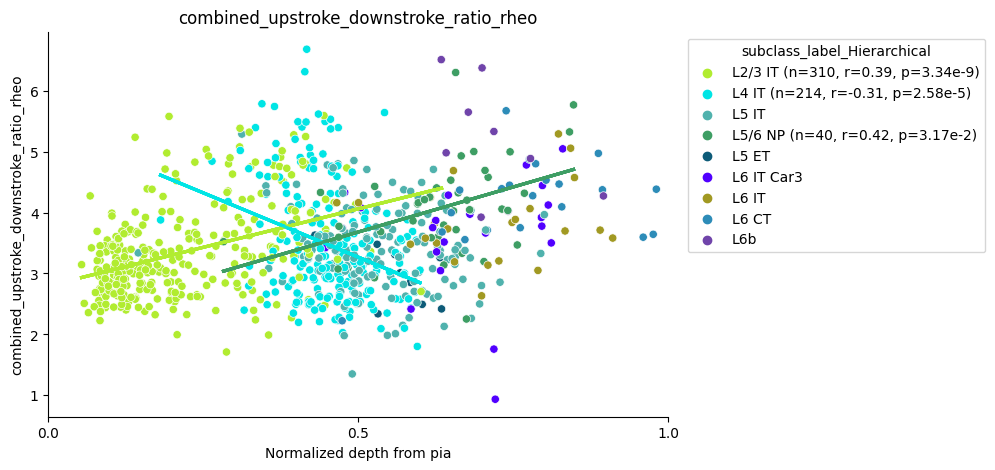

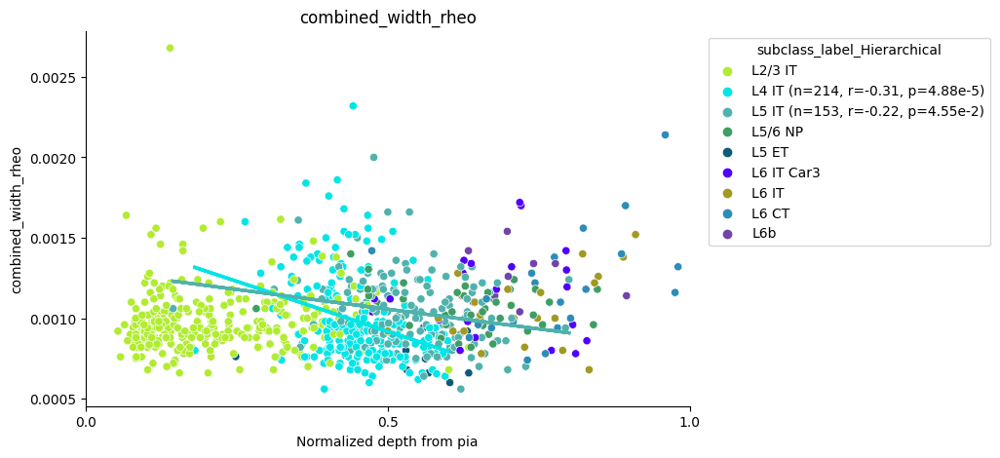

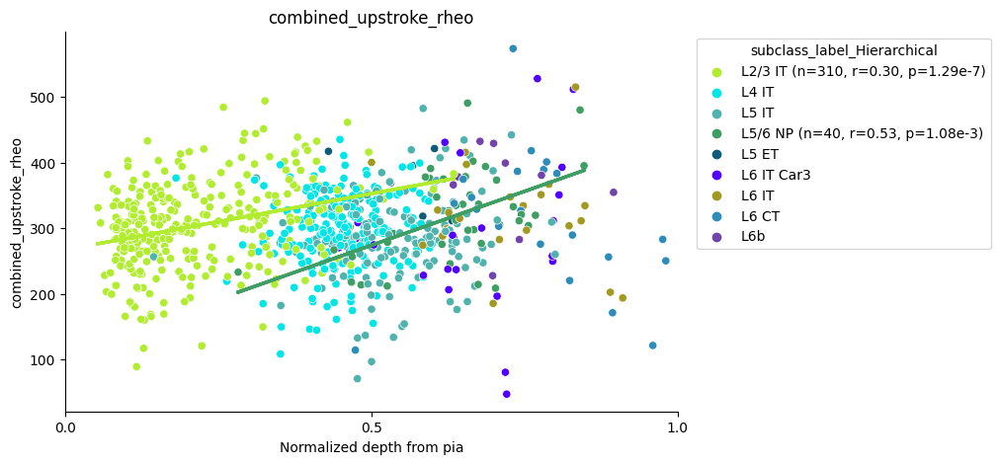

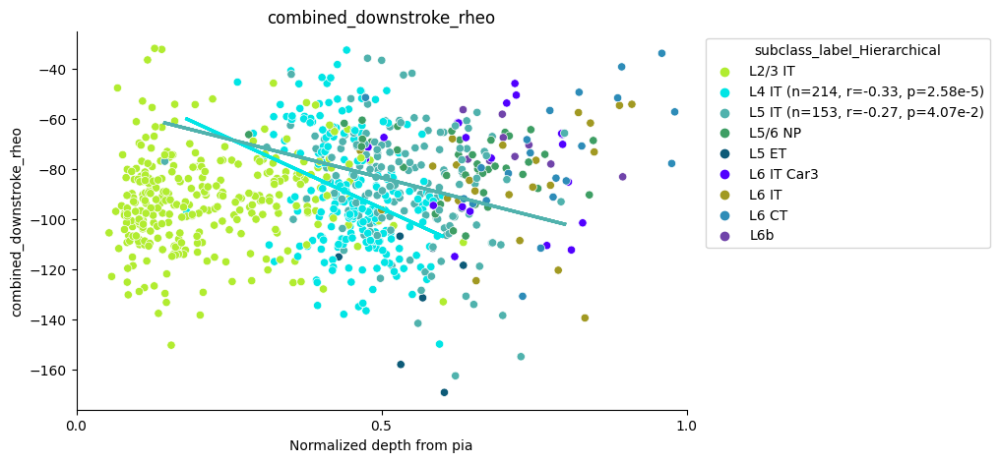

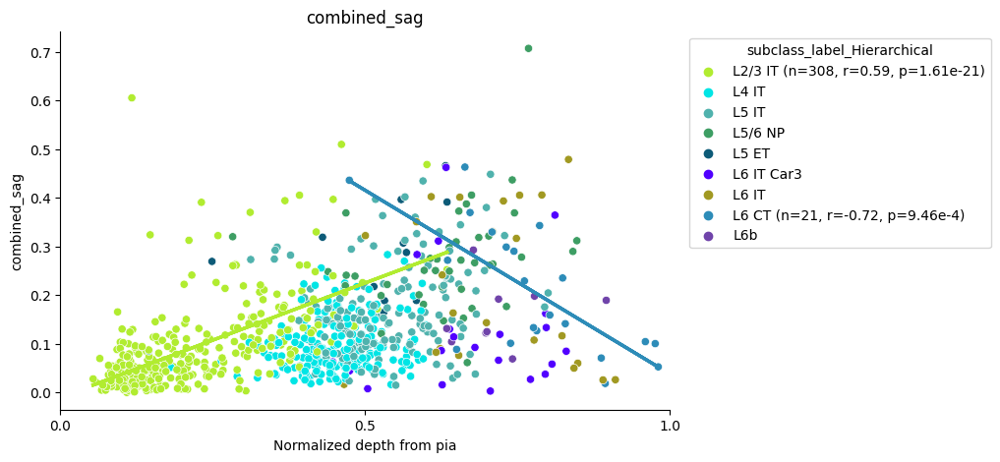

...

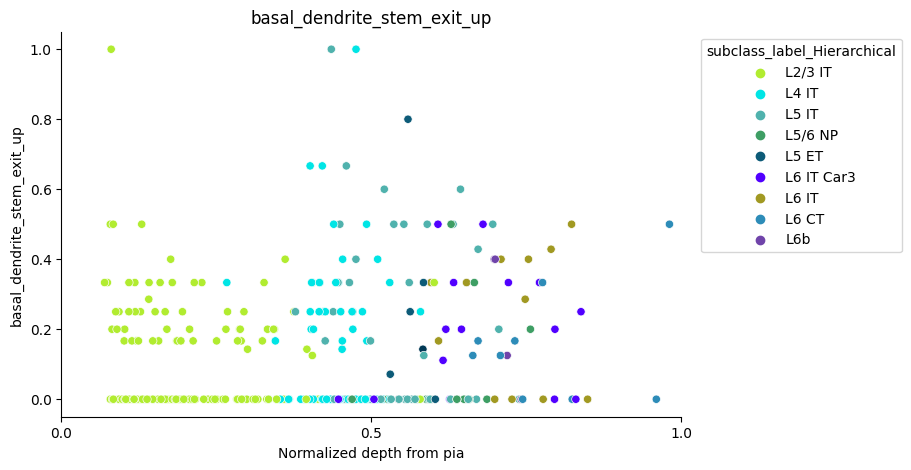

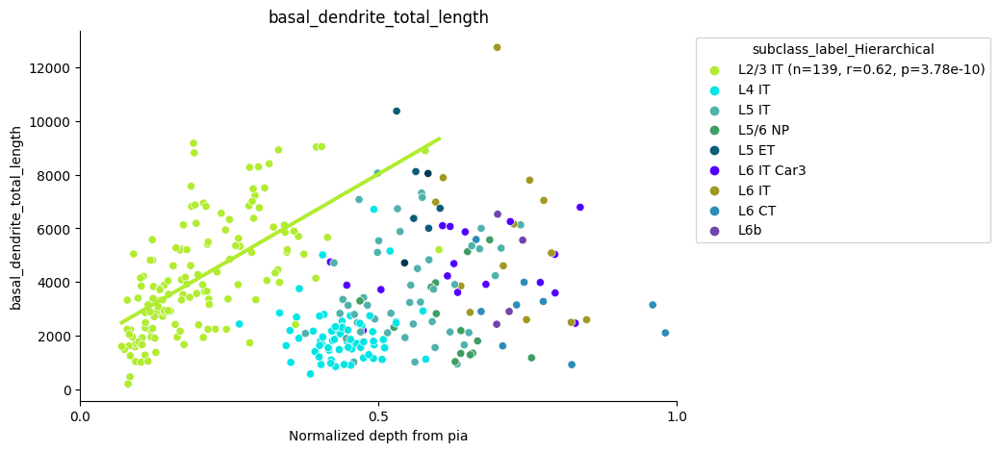

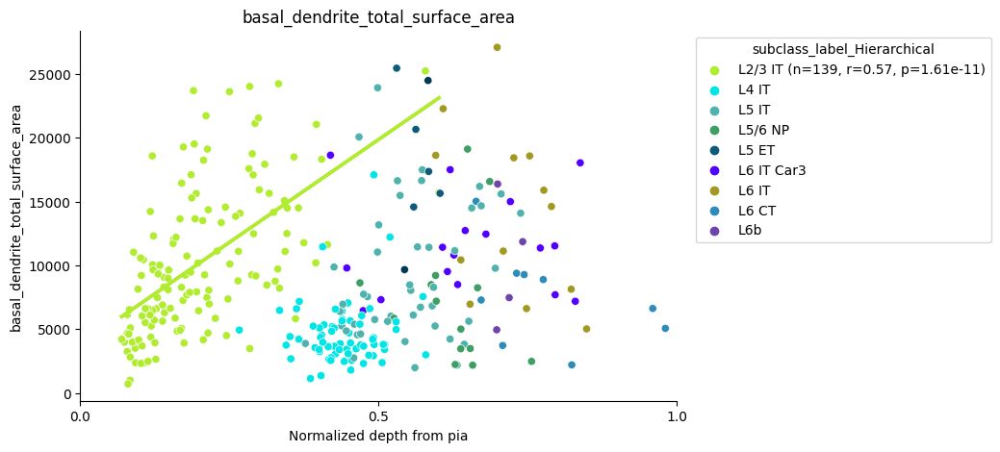

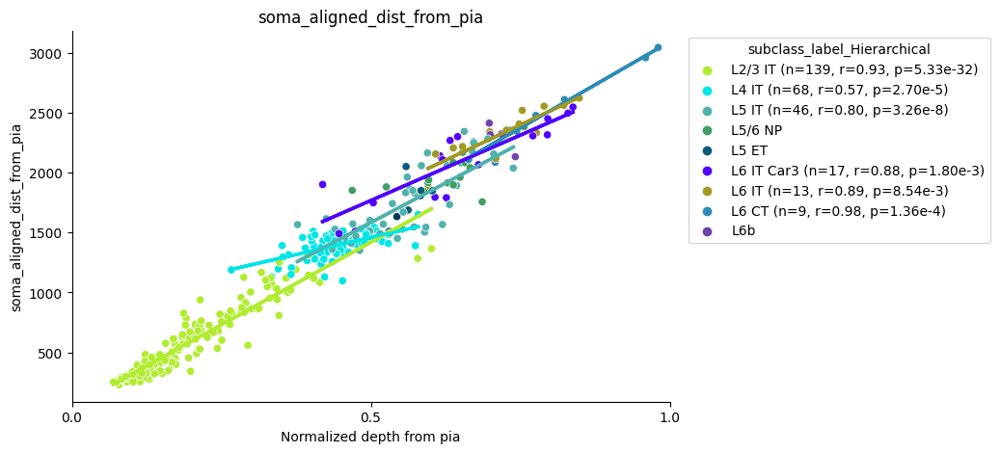

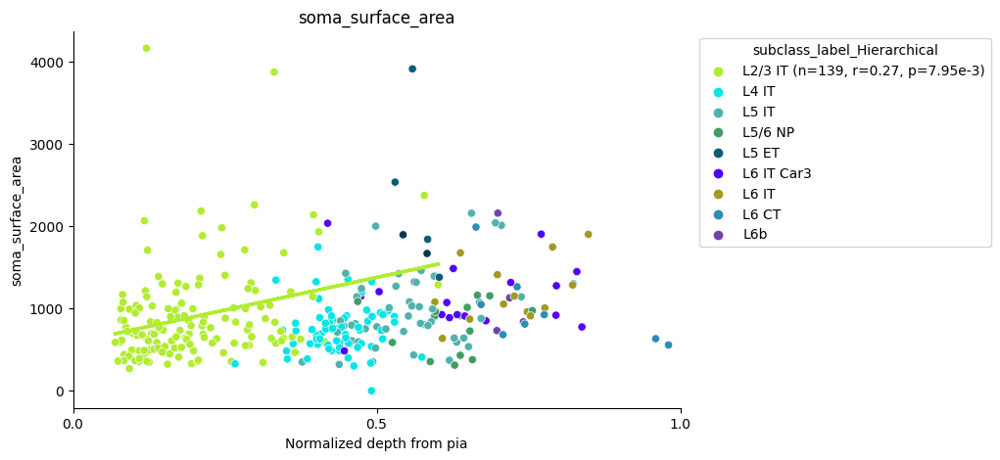

In [7]:
# Subclass level plots

depth_column = 'depth_from_pia_norm'

for modality in ['ephys', 'morpho']:
    
    if modality == 'morpho':
        feature_cols = m_features
        data = m_data
    elif modality == 'ephys':
        feature_cols = e_features
        data = e_data
    else:
        raise ValueError(f'Unknown modality: {modality}')
    
    stats_df = subclass_stats[modality]

    fig_path = os.path.join(out_dir, 'human_excitatory_depth_vs_{}_features_scatter_subclass_stats.pdf'.format(modality))
    with PdfPages(fig_path) as pdf:
        with warnings.catch_warnings():
            warnings.simplefilter(action='ignore', category=FutureWarning)

        for feat in feature_cols:

            fig, ax = plt.subplots(figsize=(8, 5))
            sns.scatterplot( data=data, x=depth_column, y=feat, hue=subclass_col, hue_order=subclass_order, palette=color_dict, ax=ax)
            sns.move_legend(ax, "upper left", bbox_to_anchor=(1.02, 1))

            legend_labels = {}
            for subclass in subclass_order:
                if subclass not in stats_df['subclass'].unique():
                    continue

                # filter significant ones for this feature
                sig = stats_df[(stats_df['feature'] == feat) & (stats_df['pval_fdr'] < 0.05)]

                for _, row in sig.iterrows():
                    subclass = row['subclass']
                    intercept, slope = row['intercept'], row['slope']
                    r = row['r']
                    pval_fdr = row['pval_fdr']
                    p_val_exp = int(np.floor(np.log10(pval_fdr)))  # Exponent of the p-value - for legend
                    p_val_mant = pval_fdr / 10**p_val_exp  # Mantissa of the p-value - for legend

                    # Get the original data points for this supertype
                    data_points = data[(data[subclass_col] == subclass)][[depth_column, feat]].dropna()
                    n_cells = len(data_points)
                    if n_cells < 3:
                        continue

                    # Predict the regression line
                    x_vals = np.linspace(data_points[depth_column].min(),
                                        data_points[depth_column].max(), 100)
                    y_vals = intercept + slope * x_vals

                    # Use the same color as the subclass
                    color = color_dict.get(subclass, 'black')
                    ax.plot(x_vals, y_vals, color=color, lw=2.2, alpha=0.9)

                    legend_labels[subclass] = f"{subclass} (n={n_cells}, r={r:.2f}, p={p_val_mant:.2f}e{p_val_exp})"

            # Update legend labels
            handles, labels = ax.get_legend_handles_labels()
            new_labels = [legend_labels.get(lbl, lbl) for lbl in labels]
            ax.legend(handles, new_labels, title=subclass_col, bbox_to_anchor=(1.02, 1), loc='upper left')

            ax.set_title(f'{feat}')
            ax.set_xlabel('Normalized depth from pia')
            ax.set_ylabel(feat)
            ax.set_xticks([0, 0.5, 1])
            ax.set_xlim((0, 1))
            sns.despine()
            pdf.savefig(fig, bbox_inches='tight')
            plt.show()
            # plt.close(fig)  # Close the figure to release memory

Subclass

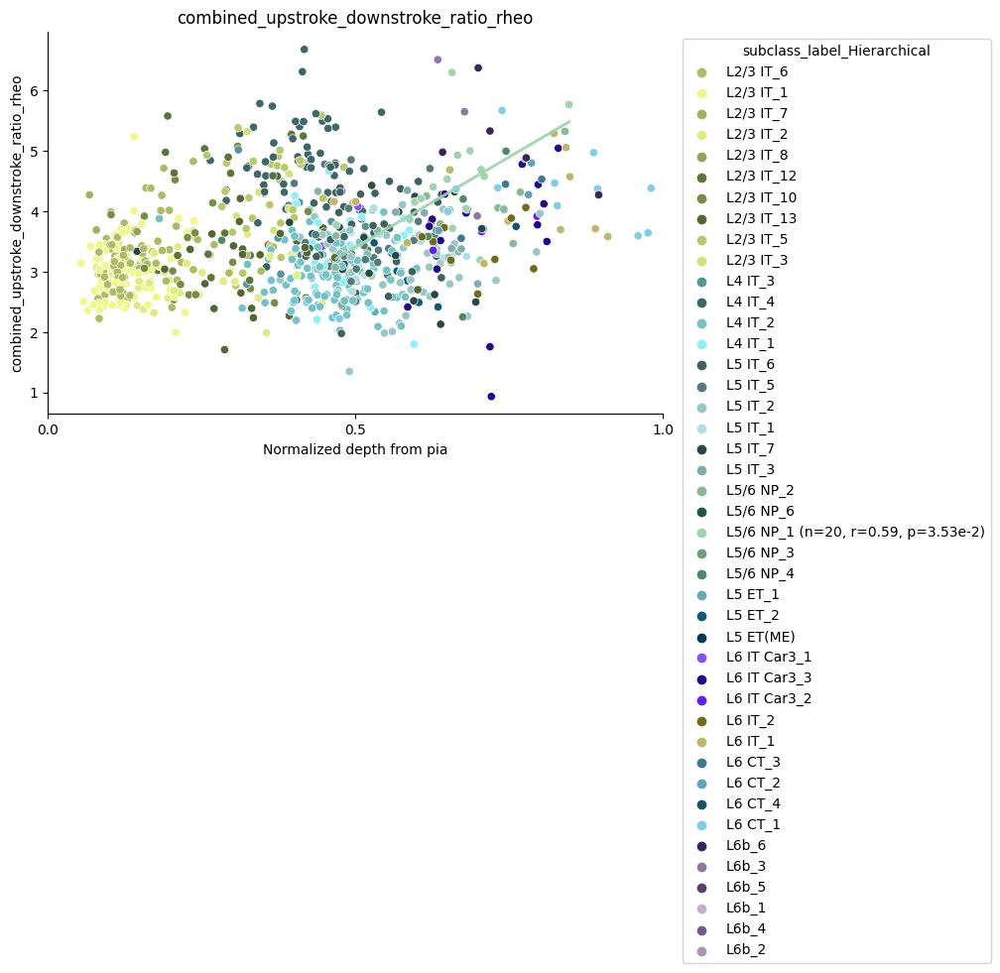

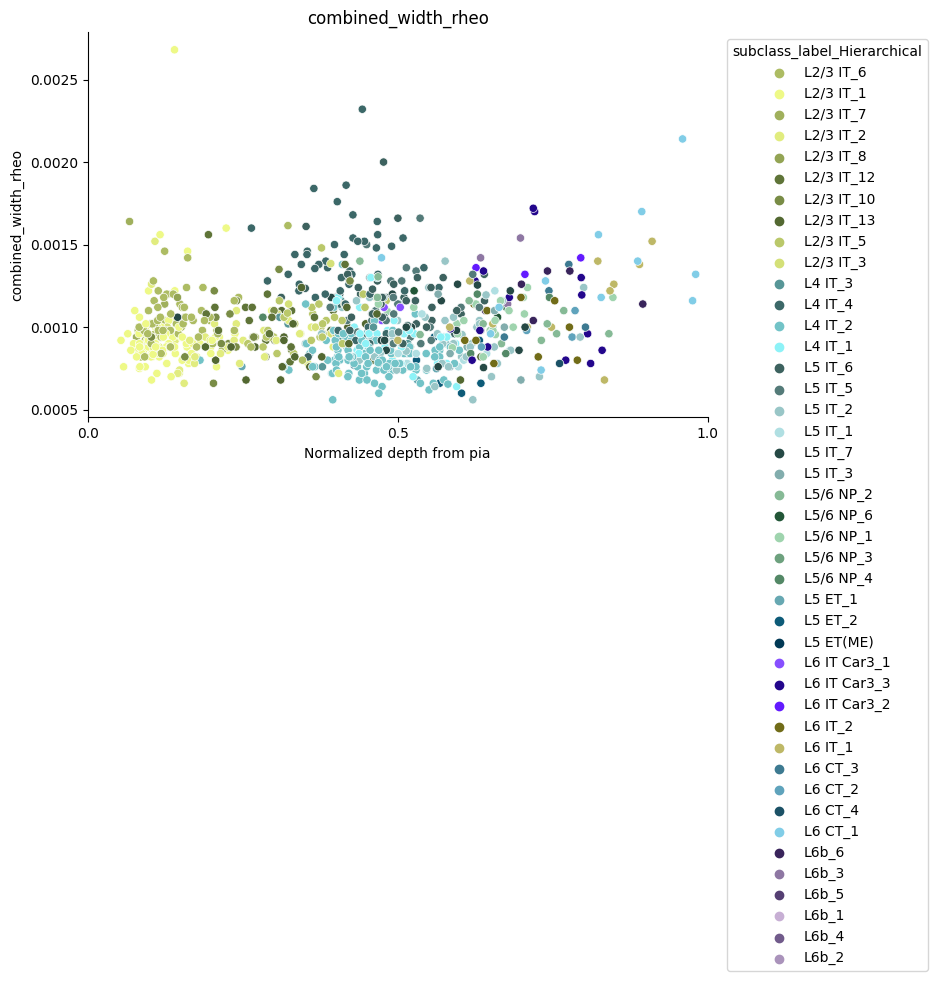

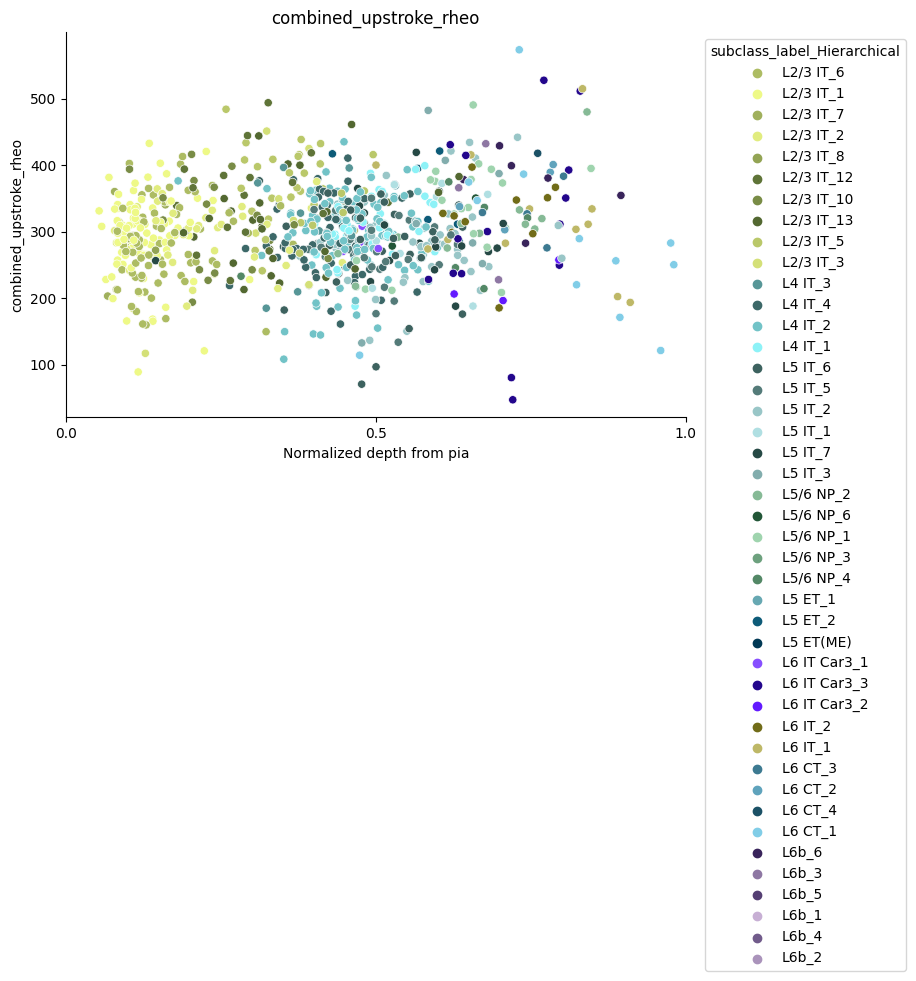

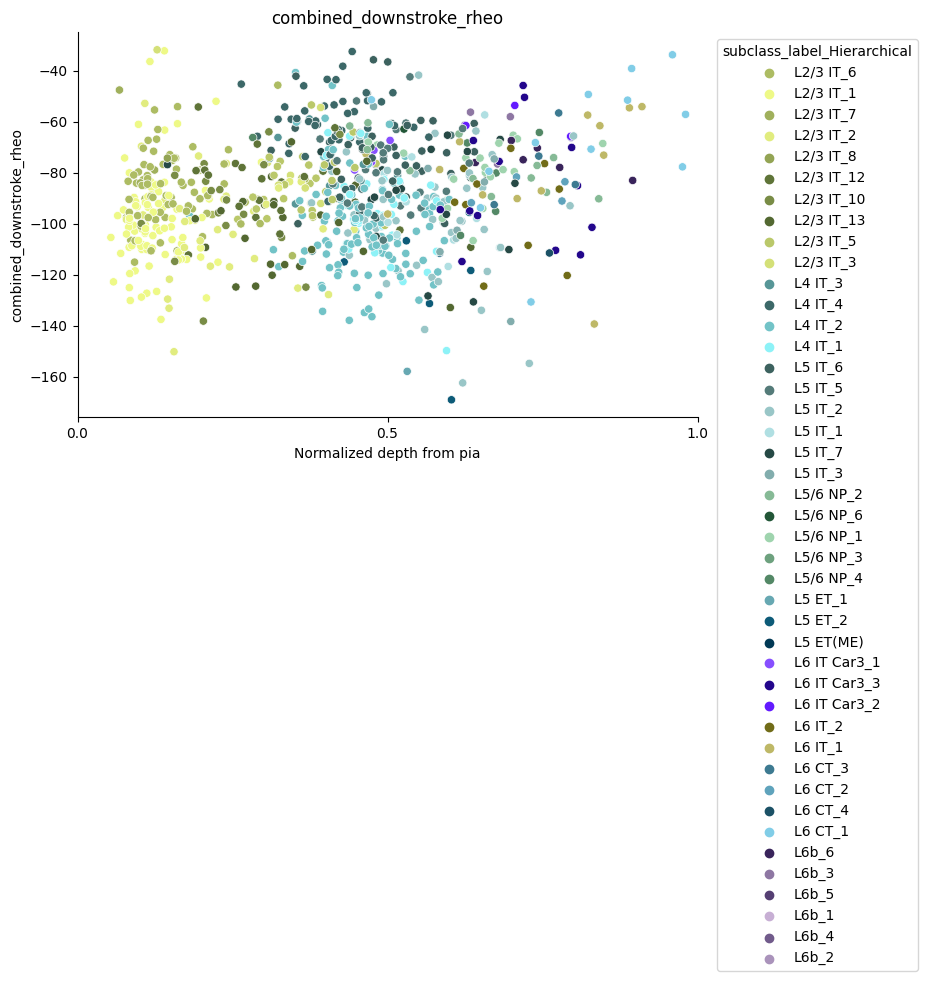

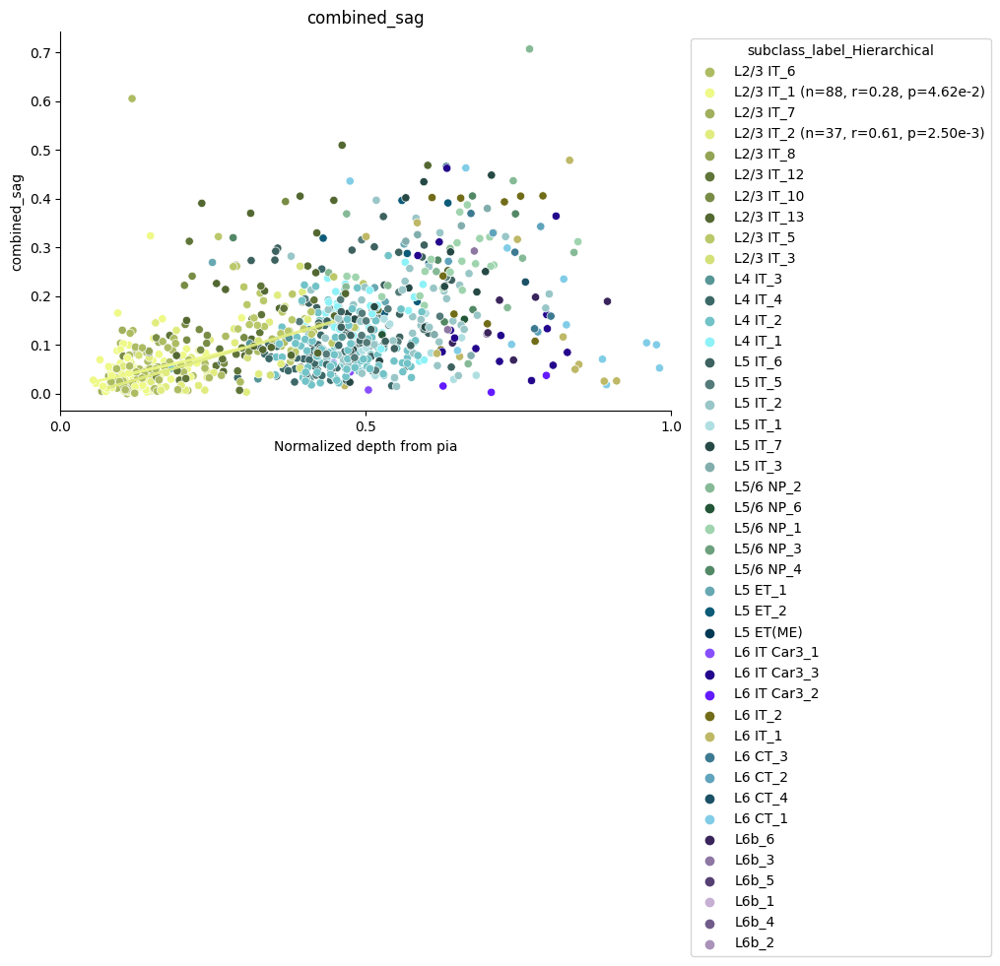

...

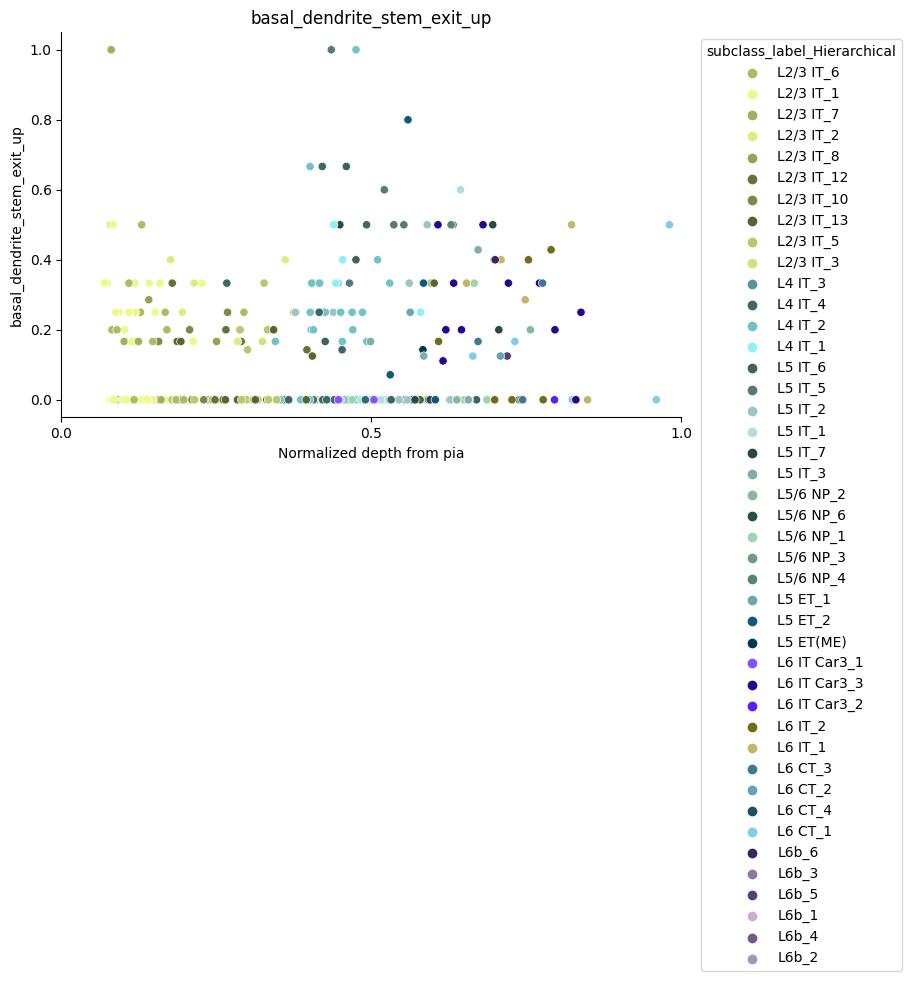

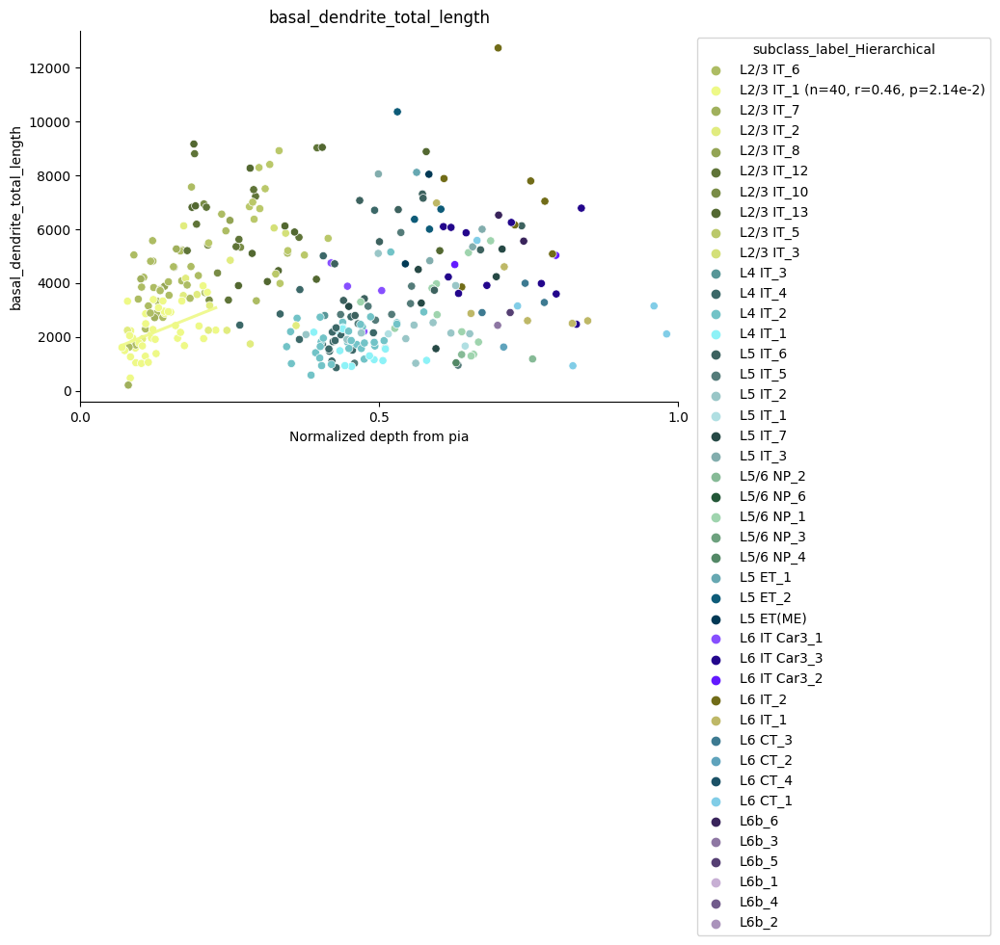

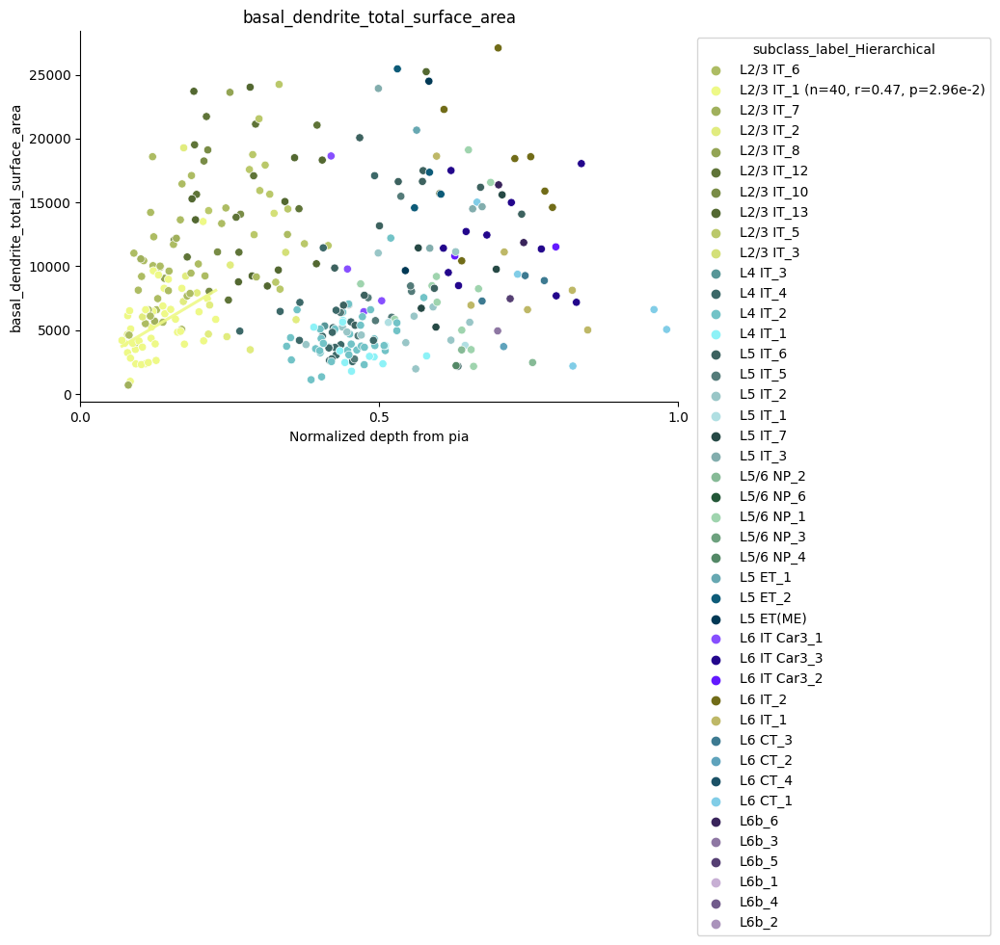

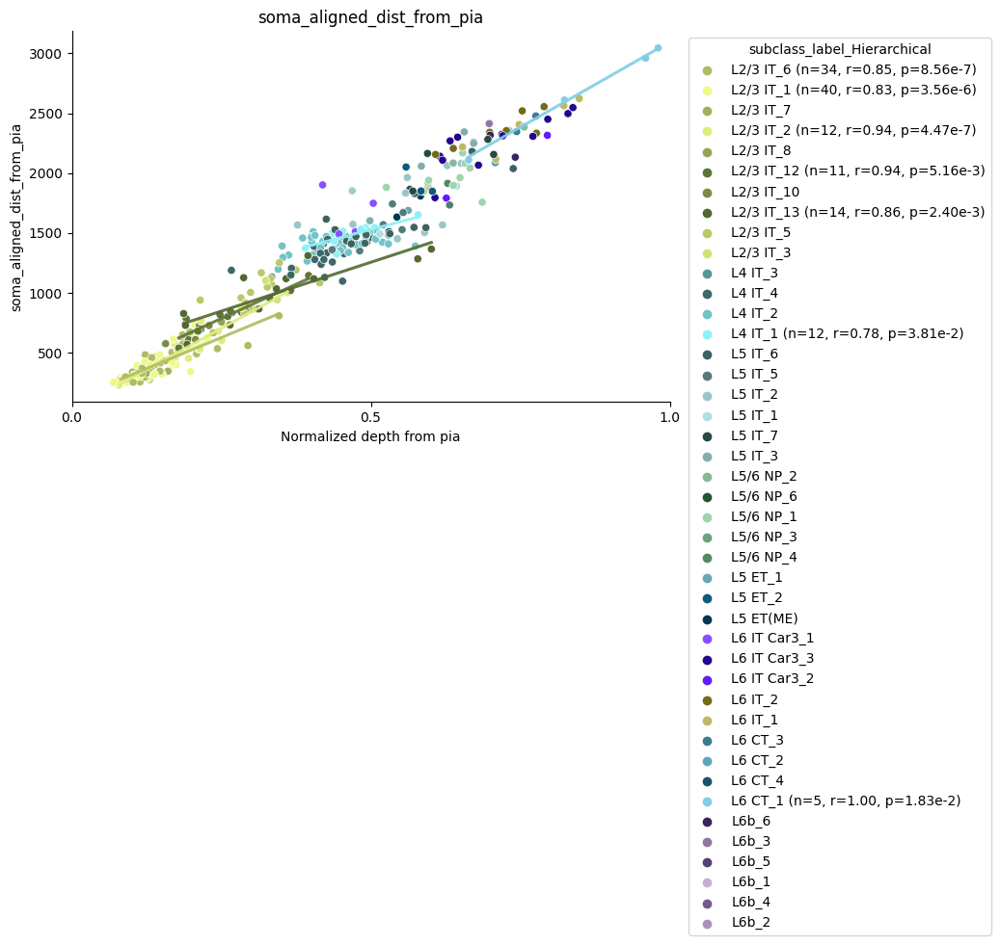

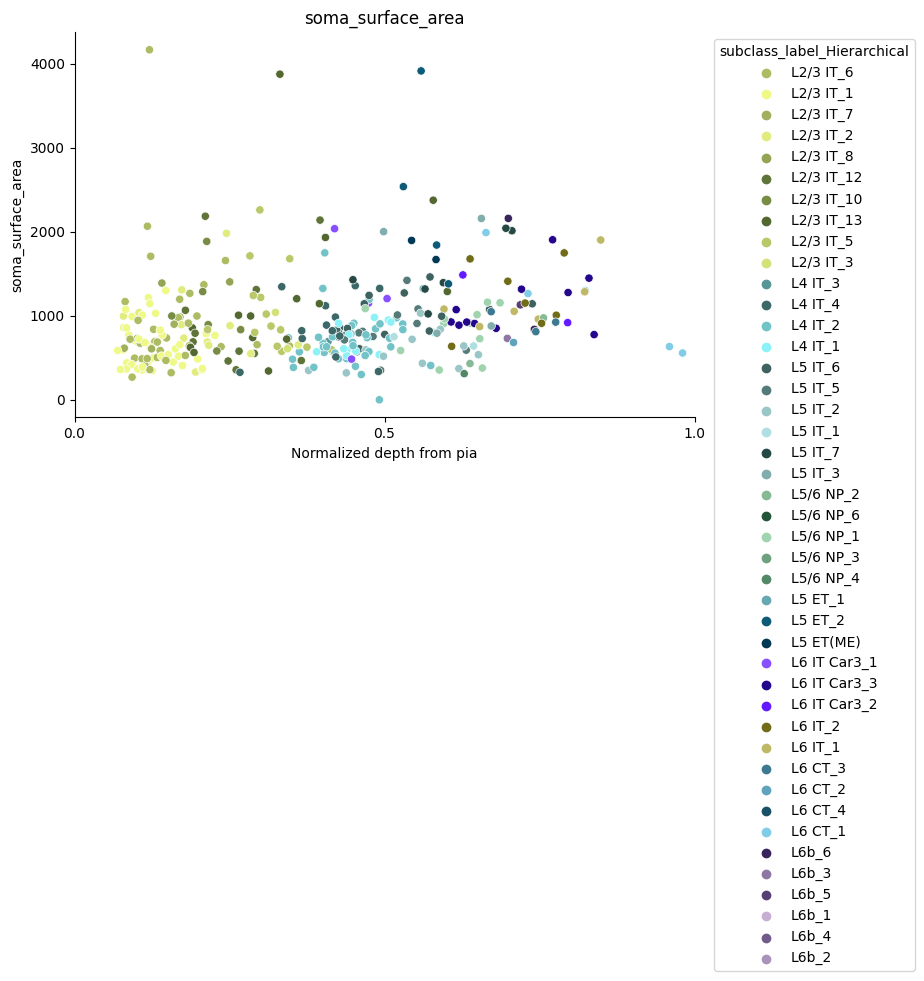

In [8]:
# Supertype level plots

depth_column = 'depth_from_pia_norm'

for modality in ['ephys', 'morpho']:
    
    if modality == 'morpho':
        feature_cols = m_features
        data = m_data
    elif modality == 'ephys':
        feature_cols = e_features
        data = e_data
    else:
        raise ValueError(f'Unknown modality: {modality}')
    
    stats_df = supertype_stats[modality]

    fig_path = os.path.join(out_dir, 'human_excitatory_depth_vs_{}_features_scatter_supertype_stats.pdf'.format(modality))
    with PdfPages(fig_path) as pdf:
        with warnings.catch_warnings():
            warnings.simplefilter(action='ignore', category=FutureWarning)

        for feat in feature_cols:
    
            fig, ax = plt.subplots(figsize=(8, 5))
            sns.scatterplot( data=data, x=depth_column, y=feat, hue=cluster_col, hue_order=ttype_order, palette=color_dict, ax=ax)
            sns.move_legend(ax, "upper left", bbox_to_anchor=(1.02, 1))

            legend_labels = {}
            for subclass in subclass_order:
                if subclass not in stats_df.keys():
                    continue

                # filter significant ones for this feature
                sig = stats_df[subclass][(stats_df[subclass]['feature'] == feat) & (stats_df[subclass]['pval_fdr'] < 0.05)]

                for _, row in sig.iterrows():
                    supertype = row['supertype']
                    intercept, slope = row['intercept'], row['slope']
                    r = row['r']
                    pval_fdr = row['pval_fdr']
                    p_val_exp = int(np.floor(np.log10(pval_fdr)))  # Exponent of the p-value - for legend
                    p_val_mant = pval_fdr / 10**p_val_exp  # Mantissa of the p-value - for legend

                    # Get the original data points for this supertype
                    data_points = data[(data[cluster_col] == supertype)][[depth_column, feat]].dropna()
                    n_cells = len(data_points)
                    if n_cells < 3:
                        continue

                    # Predict the regression line
                    x_vals = np.linspace(data_points[depth_column].min(),
                                        data_points[depth_column].max(), 100)
                    y_vals = intercept + slope * x_vals

                    # Use the same color as the subclass
                    color = color_dict.get(supertype, 'black')
                    ax.plot(x_vals, y_vals, color=color, lw=2.2, alpha=0.9)

                    legend_labels[supertype] = f"{supertype} (n={n_cells}, r={r:.2f}, p={p_val_mant:.2f}e{p_val_exp})"

            # Update legend labels
            handles, labels = ax.get_legend_handles_labels()
            new_labels = [legend_labels.get(lbl, lbl) for lbl in labels]
            ax.legend(handles, new_labels, title=subclass_col, bbox_to_anchor=(1.02, 1), loc='upper left')

            ax.set_title(f'{feat}')
            ax.set_xlabel('Normalized depth from pia')
            ax.set_ylabel(feat)
            ax.set_xticks([0, 0.5, 1])
            ax.set_xlim((0, 1))
            sns.despine()
            pdf.savefig(fig, bbox_inches='tight')
            plt.show()
            # plt.close(fig)  # Close the figure to release memory

Layer

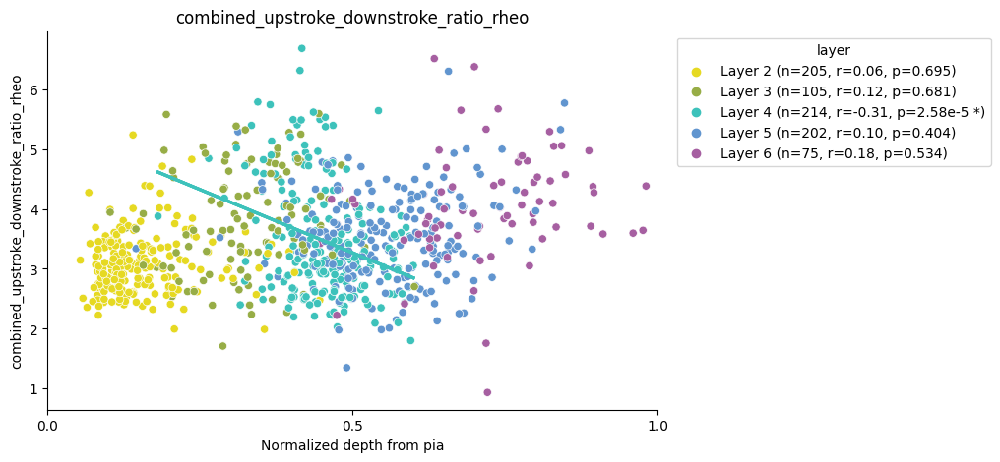

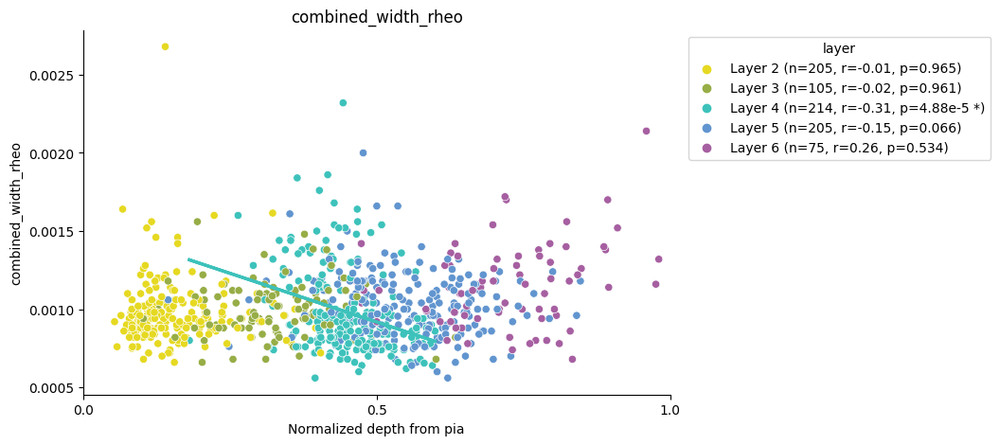

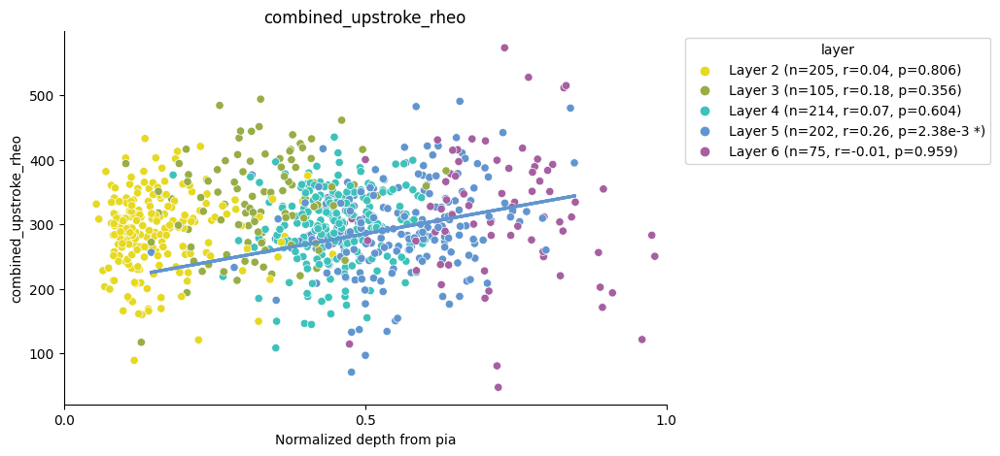

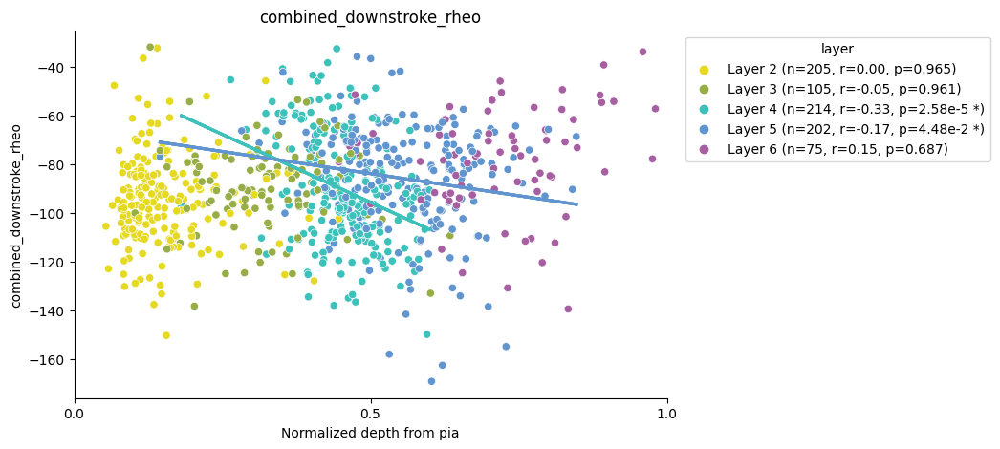

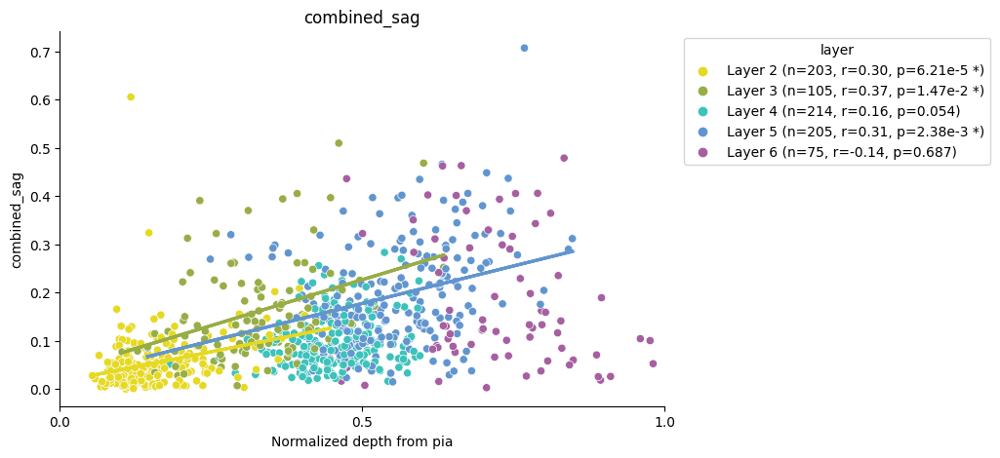

...

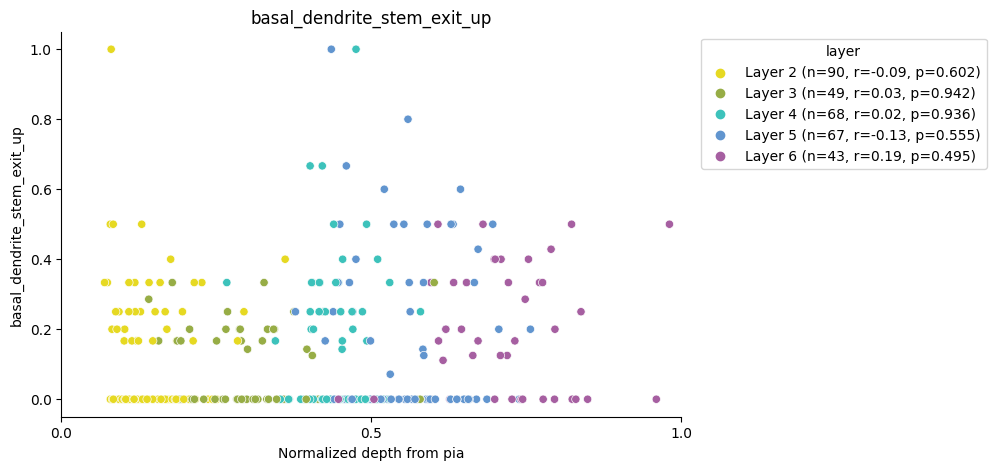

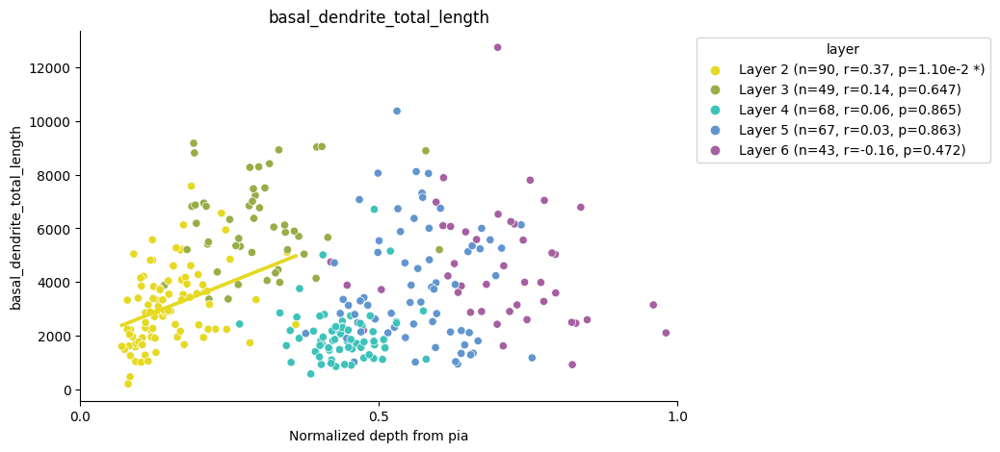

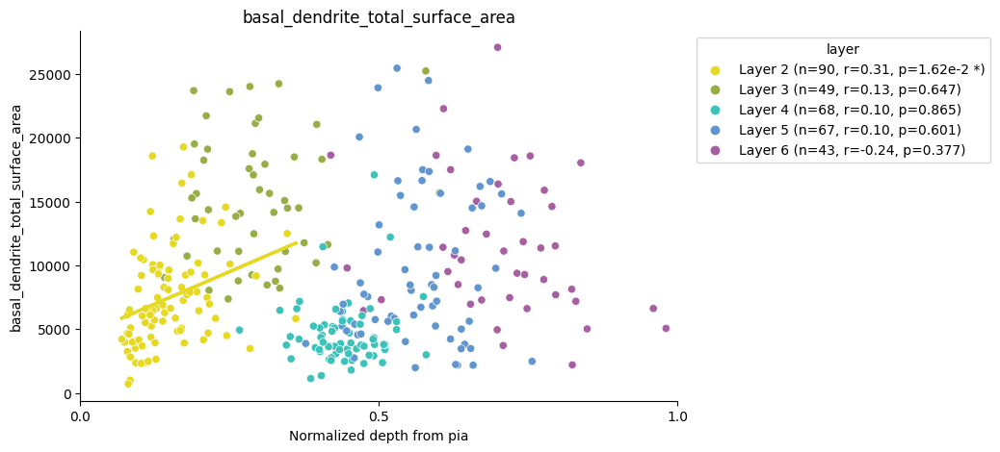

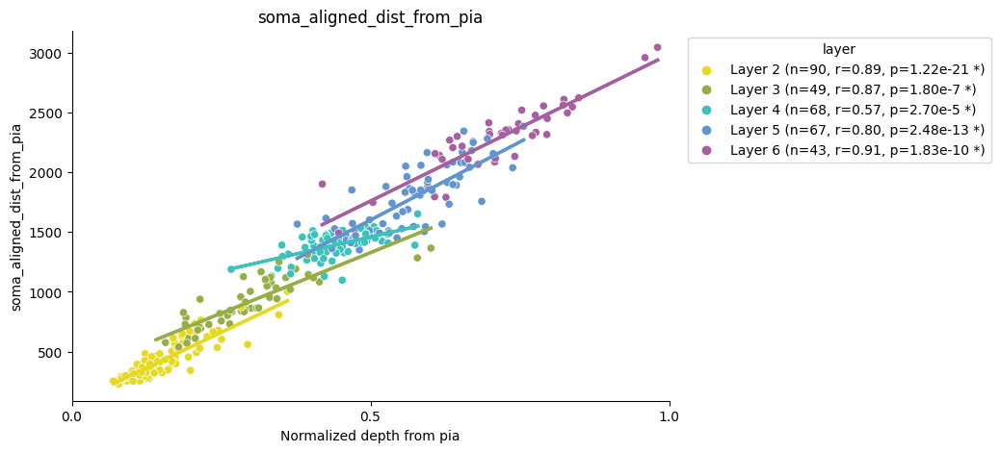

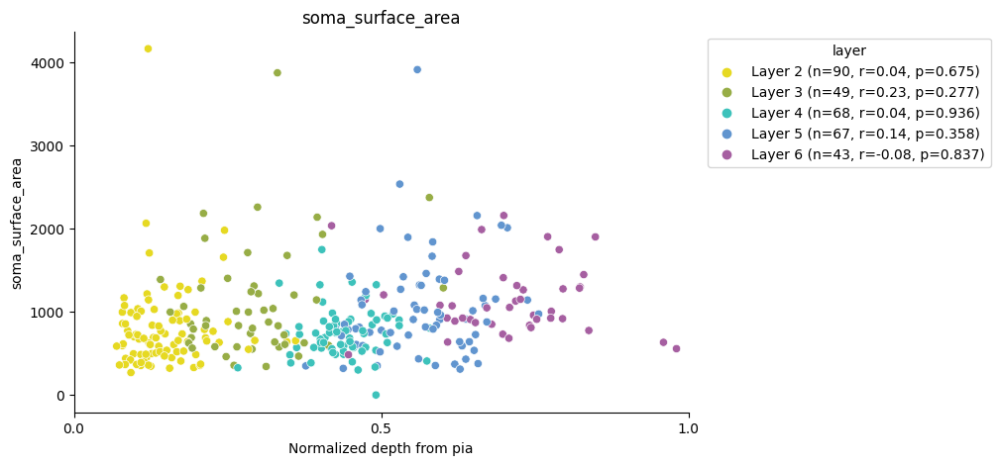

In [24]:
# Layer level plots

depth_column = 'depth_from_pia_norm'

layer_order = group_order['layer']
layer_col = 'layer'

layer_color_dict = {
    'Layer 2': "#E6D922",  # golden ochre
    'Layer 3': "#97AD46",  # botanical green
    'Layer 4': "#3DC2BB",  # turquoise
    'Layer 5': "#6195CF",  # periwinkle blue
    'Layer 6': "#A65FA1"   # orchid purple
}

for modality in ['ephys', 'morpho']:
    
    if modality == 'morpho':
        feature_cols = m_features
        data = m_data
    elif modality == 'ephys':
        feature_cols = e_features
        data = e_data
    else:
        raise ValueError(f'Unknown modality: {modality}')
    
    stats_df = layer_stats[modality]

    fig_path = os.path.join(out_dir, 'human_excitatory_depth_vs_{}_features_scatter_layer_stats_rainbow.pdf'.format(modality))
    with PdfPages(fig_path) as pdf:
        with warnings.catch_warnings():
            warnings.simplefilter(action='ignore', category=FutureWarning)

        for feat in feature_cols:

            fig, ax = plt.subplots(figsize=(8, 5))
            sns.scatterplot( data=data, x=depth_column, y=feat, hue=layer_col, hue_order=layer_order, palette=layer_color_dict, ax=ax)
            sns.move_legend(ax, "upper left", bbox_to_anchor=(1.02, 1))

            for l in layer_order:                     
                legend_labels[l] = f'{l} (n={len(data[(data[layer_col] == l)][[depth_column, feat]].dropna())})'

            legend_labels = {}
            for layer in layer_order:
                if layer not in stats_df['layer'].unique():
                    continue

                # filter significant ones for this feature
                # sig = stats_df[(stats_df['feature'] == feat) & (stats_df['pval_fdr'] < 0.05)]

                for _, row in stats_df[(stats_df['feature'] == feat)].iterrows():
                    this_layer = row['layer']
                    intercept, slope = row['intercept'], row['slope']
                    r = row['r']
                    pval_fdr = row['pval_fdr']
                    p_val_exp = int(np.floor(np.log10(pval_fdr)))  # Exponent of the p-value - for legend
                    p_val_mant = pval_fdr / 10**p_val_exp  # Mantissa of the p-value - for legend

                    # Get the original data points for this supertype
                    data_points = data[(data[layer_col] == this_layer)][[depth_column, feat]].dropna()
                    n_cells = len(data_points)
                    if n_cells < 3:
                        continue

                    if pval_fdr < 0.05:

                        # Predict the regression line
                        x_vals = np.linspace(data_points[depth_column].min(),
                                            data_points[depth_column].max(), 100)
                        y_vals = intercept + slope * x_vals

                        # Use the same color as the layer
                        color = layer_color_dict.get(this_layer, 'black')
                        ax.plot(x_vals, y_vals, color=color, lw=2.2, alpha=0.9)
                        
                        legend_labels[this_layer] = f"{this_layer} (n={n_cells}, r={r:.2f}, p={p_val_mant:.2f}e{p_val_exp} *)"
                    else: 
                        legend_labels[this_layer] = f"{this_layer} (n={n_cells}, r={r:.2f}, p={pval_fdr:.3f})"

            # Update legend labels
            handles, labels = ax.get_legend_handles_labels()
            new_labels = [legend_labels.get(lbl, lbl) for lbl in labels]
            ax.legend(handles, new_labels, title=layer_col, bbox_to_anchor=(1.02, 1), loc='upper left')

            ax.set_title(f'{feat}')
            ax.set_xlabel('Normalized depth from pia')
            ax.set_ylabel(feat)
            ax.set_xticks([0, 0.5, 1])
            ax.set_xlim((0, 1))
            sns.despine()
            pdf.savefig(fig, bbox_inches='tight')
            plt.show()
            # plt.close(fig)  # Close the figure to release memory

# Special depth plots

### L2 vs L3 supertypes - show with different marker fills, plot any signif supertype pval regression lines

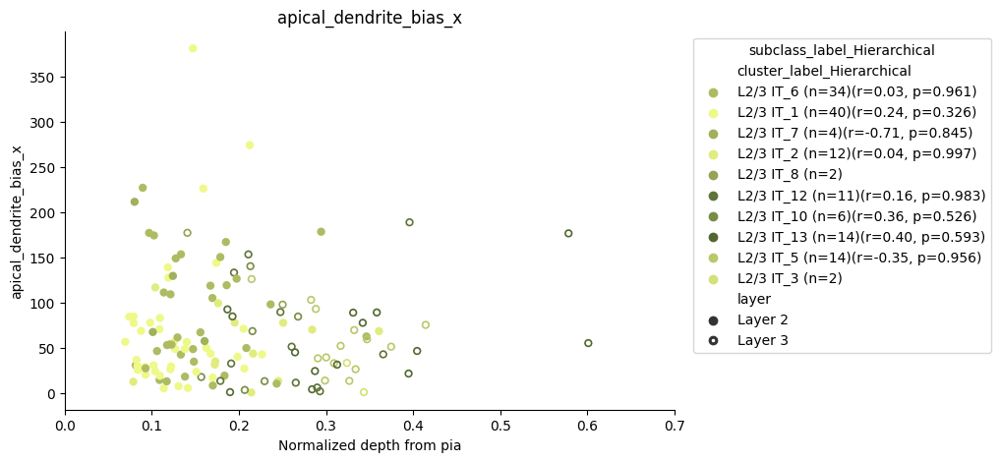

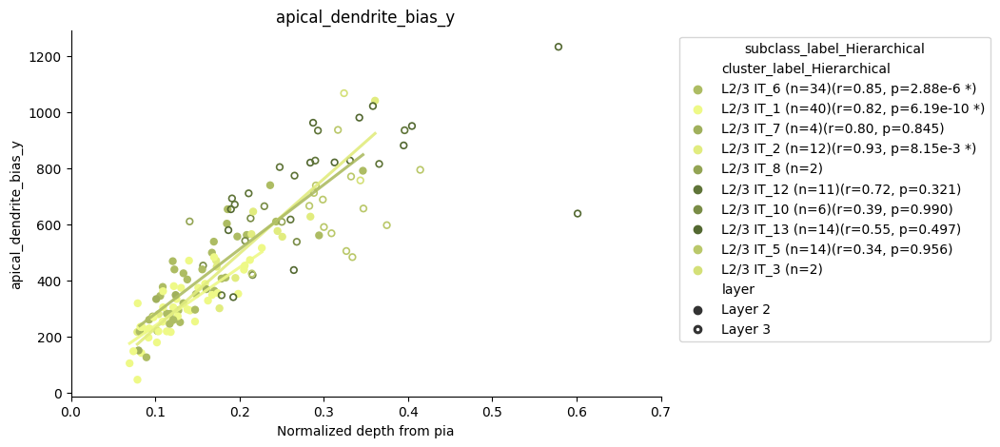

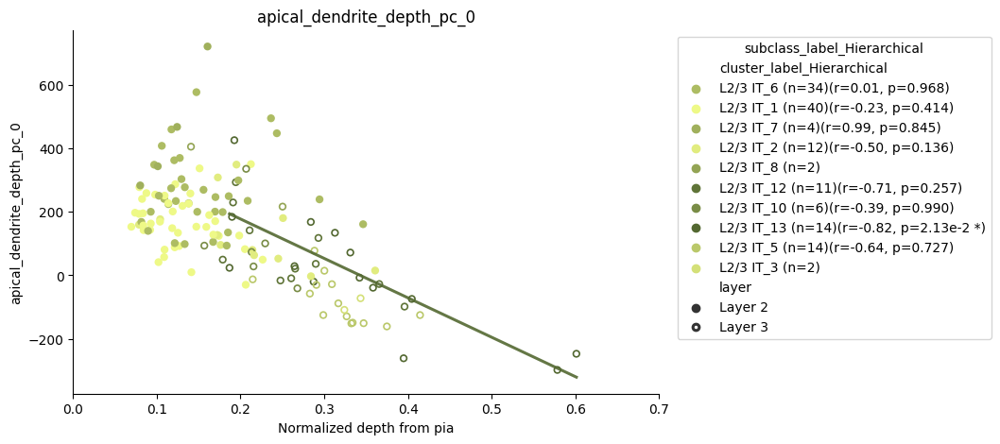

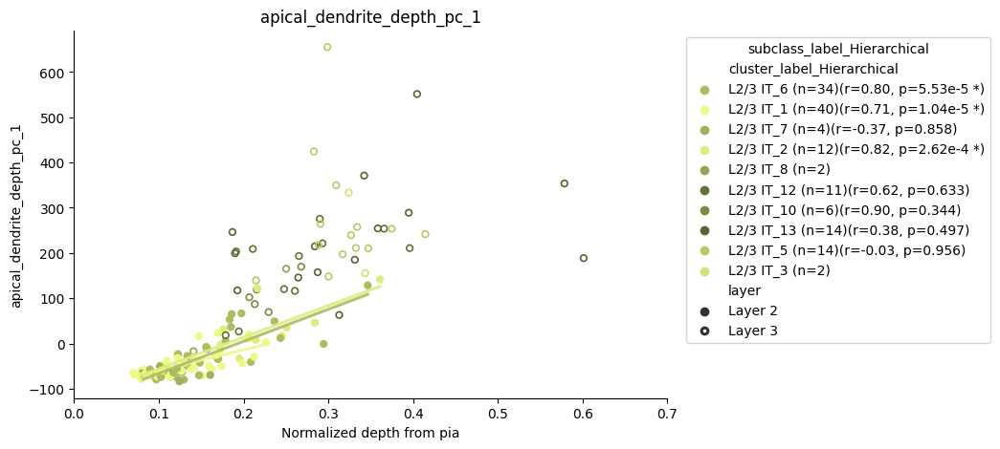

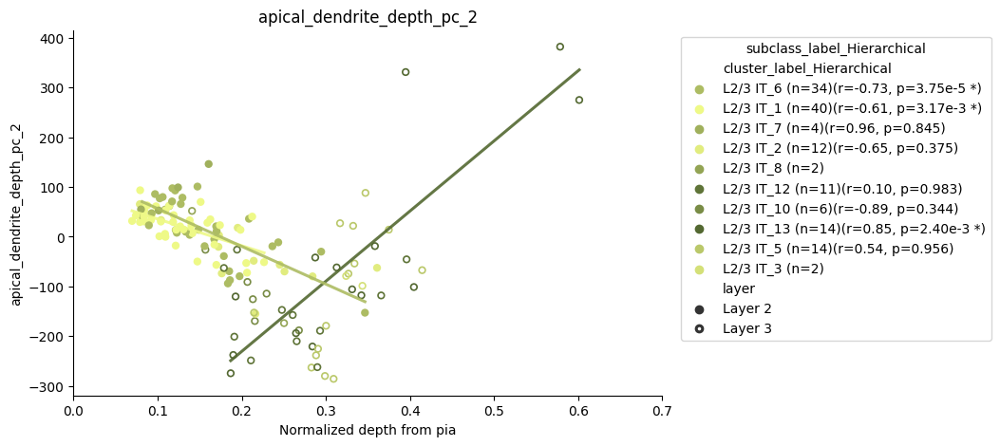

...

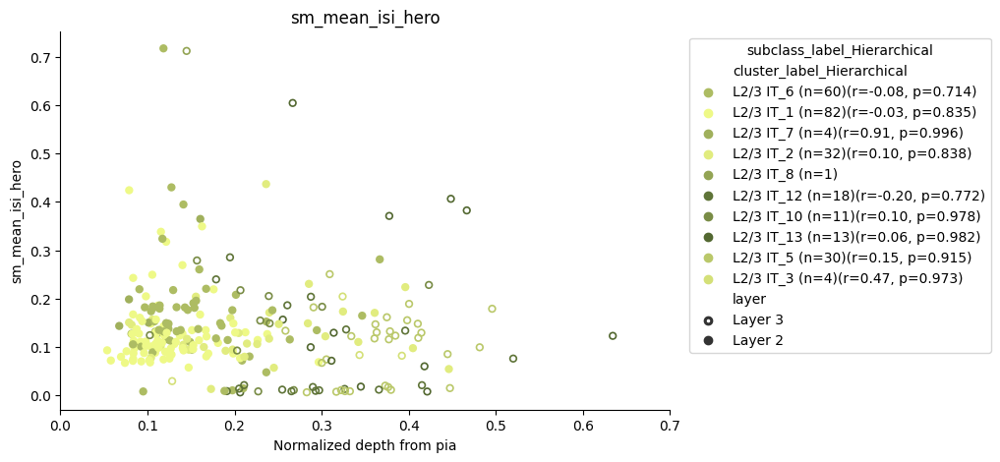

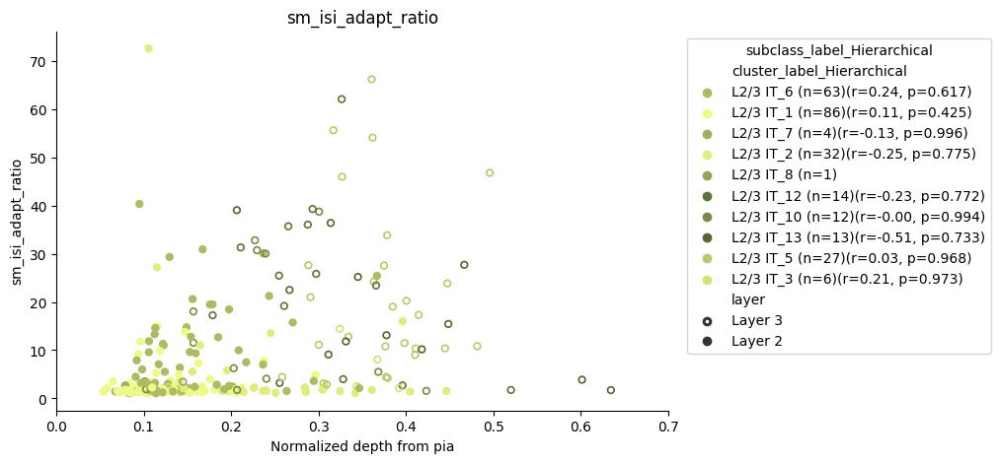

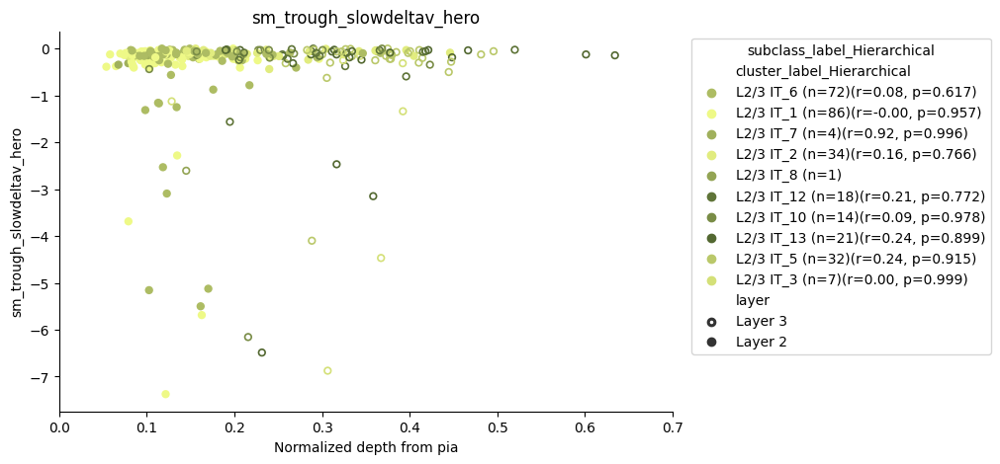

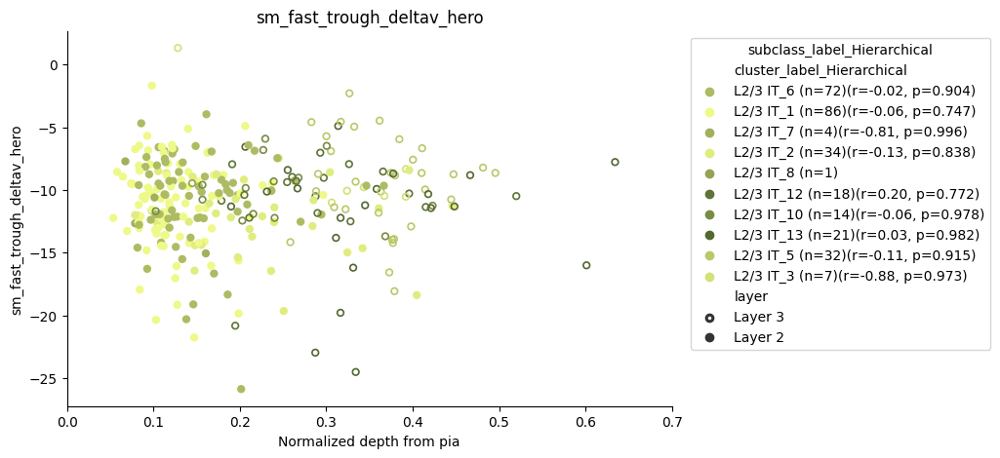

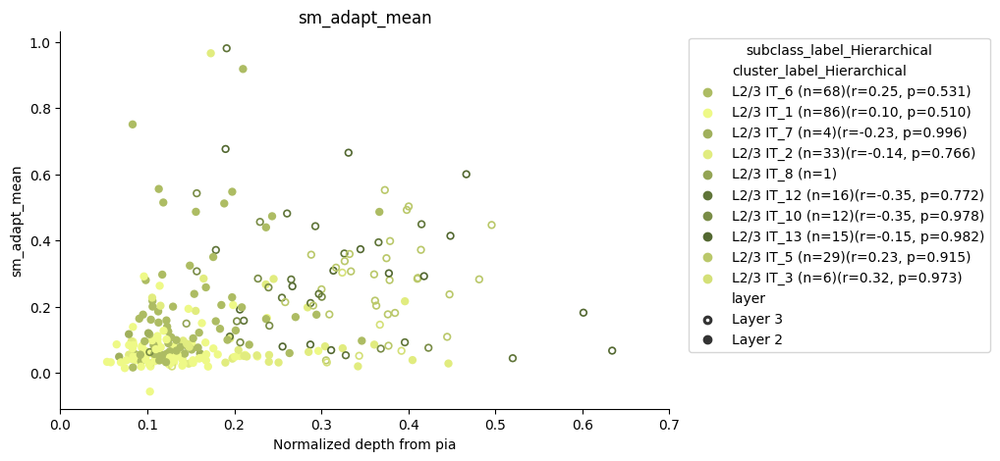

In [14]:
# Supertype level plots

depth_column = 'depth_from_pia_norm'


for modality in ['morpho', 'ephys']:
    
    if modality == 'morpho':
        feature_cols = m_features
        data = m_data
    elif modality == 'ephys':
        feature_cols = e_features
        data = e_data
    else:
        raise ValueError(f'Unknown modality: {modality}')
    
    stats_df = supertype_stats[modality]
    data = data[data.layer.isin(['Layer 2', 'Layer 3'])]

    fig_path = os.path.join(out_dir, 'human_excitatory_depth_vs_{}_features_scatter_L2_L3_supertype_stats.pdf'.format(modality))
    with PdfPages(fig_path) as pdf:
        with warnings.catch_warnings():
            warnings.simplefilter(action='ignore', category=FutureWarning)

        for feat in feature_cols:
    
            fig, ax = plt.subplots(figsize=(8, 5))
            hue_order = [t for t in ttype_order if t in data[cluster_col].unique()]
            sns.scatterplot( data=data, x=depth_column, y=feat, hue=cluster_col, hue_order=hue_order, 
                            palette=color_dict, ax=ax, style='layer', markers={'Layer 2': 'o', 'Layer 3': "$\circ$"}, linewidth=0)
            sns.move_legend(ax, "upper left", bbox_to_anchor=(1.02, 1))

            legend_labels = {}
            for ttype in hue_order:                     
                legend_labels[ttype] = f'{ttype} (n={len(data[(data[cluster_col] == ttype)][[depth_column, feat]].dropna())})'

            for subclass in ['L2/3 IT']:
                if subclass not in stats_df.keys():
                    continue

                for _, row in stats_df[subclass][(stats_df[subclass]['feature'] == feat)].iterrows():
                    supertype = row['supertype']
                    intercept, slope = row['intercept'], row['slope']
                    r = row['r']
                    pval_fdr = row['pval_fdr']
                    p_val_exp = int(np.floor(np.log10(pval_fdr)))  # Exponent of the p-value - for legend
                    p_val_mant = pval_fdr / 10**p_val_exp  # Mantissa of the p-value - for legend

                    # Get the original data points for this supertype
                    data_points = data[(data[cluster_col] == supertype)][[depth_column, feat]].dropna()
                    n_cells = len(data_points)
                    if n_cells < 3:
                        continue

                    if pval_fdr < 0.05: 
                        # Predict the regression line
                        x_vals = np.linspace(data_points[depth_column].min(),
                                            data_points[depth_column].max(), 100)
                        y_vals = intercept + slope * x_vals

                        # Use the same color as the subclass
                        color = color_dict.get(supertype, 'black')
                        ax.plot(x_vals, y_vals, color=color, lw=2.2, alpha=0.9)
                
                        legend_labels[supertype] = legend_labels[supertype] + f" (r={r:.2f}, p={p_val_mant:.2f}e{p_val_exp} *)"
                    else:
                        legend_labels[supertype] = legend_labels[supertype] + f" (r={r:.2f}, p={pval_fdr:.3f})"



            # Update legend labels
            handles, labels = ax.get_legend_handles_labels()
            new_labels = [legend_labels.get(lbl, lbl) for lbl in labels]
            ax.legend(handles, new_labels, title=subclass_col, bbox_to_anchor=(1.02, 1), loc='upper left')

            ax.set_title(f'{feat}')
            ax.set_xlabel('Normalized depth from pia')
            ax.set_ylabel(feat)
            ax.set_xlim((0, 0.7))
            sns.despine()
            pdf.savefig(fig, bbox_inches='tight')
            plt.show()
            # plt.close(fig)  # Close the figure to release memory

One off plot each supertype L2 L3 for a single figure in its own plot

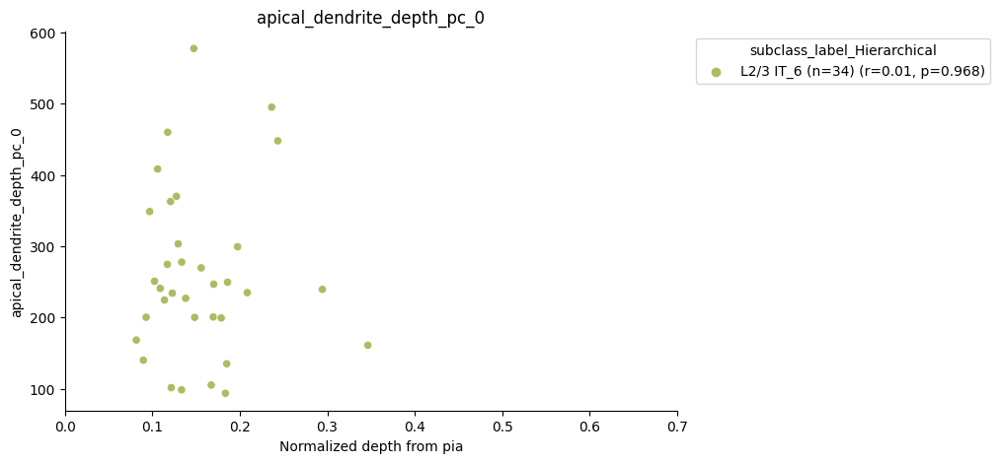

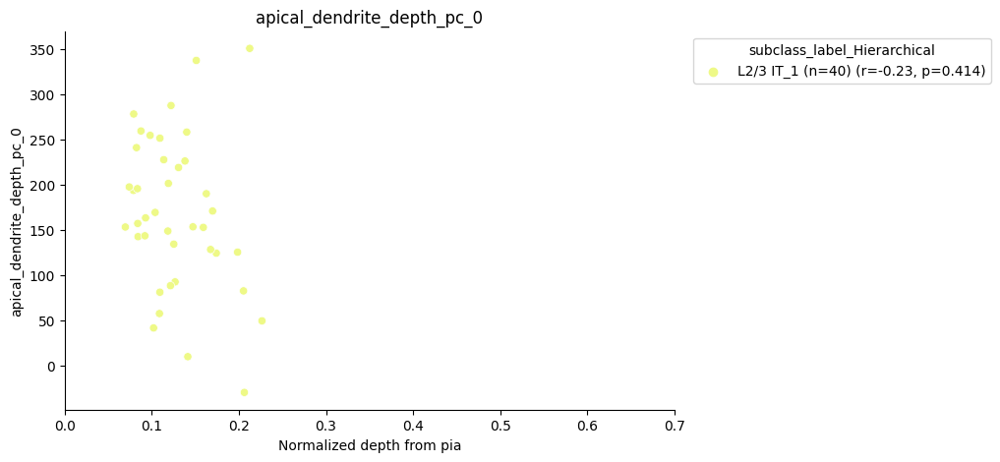

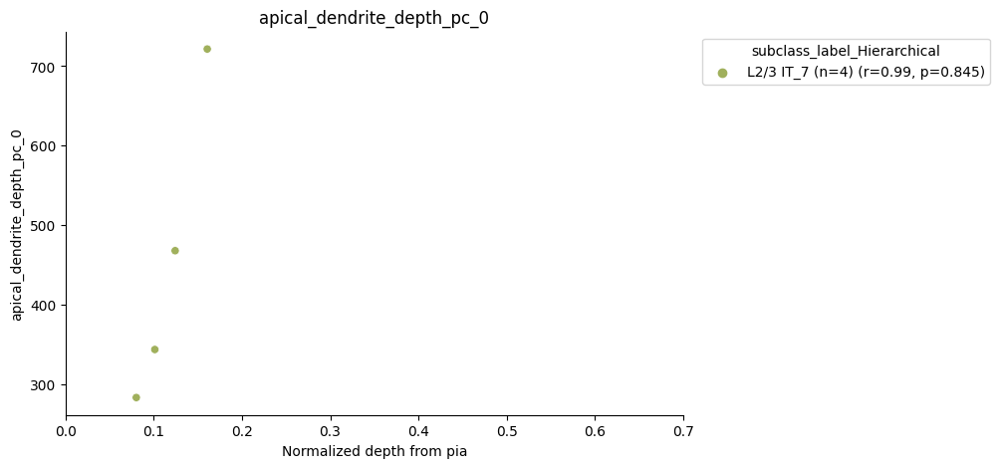

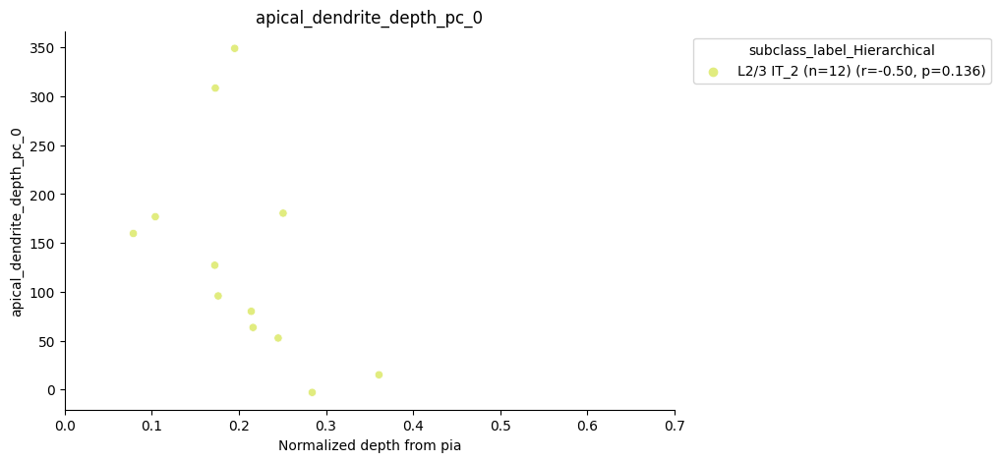

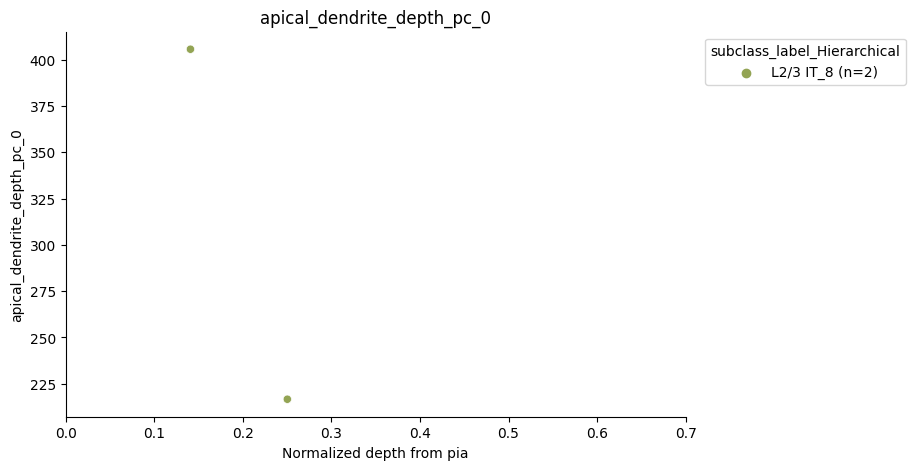

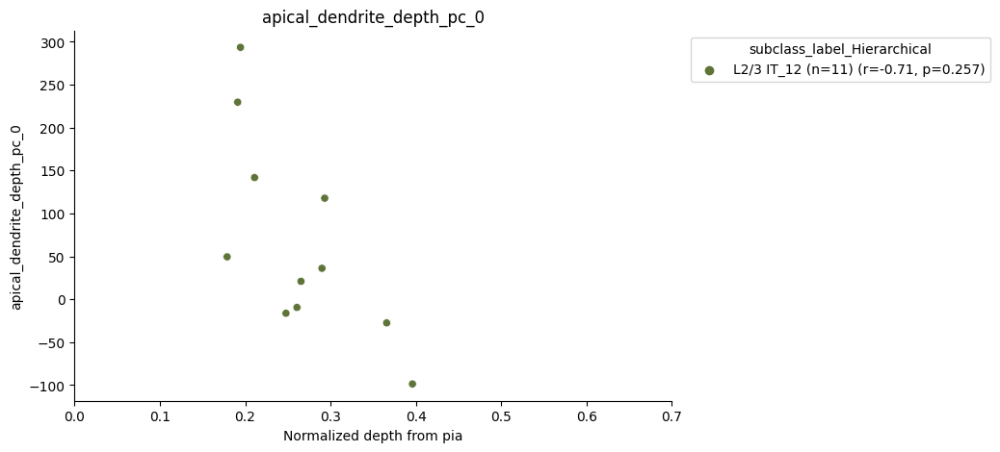

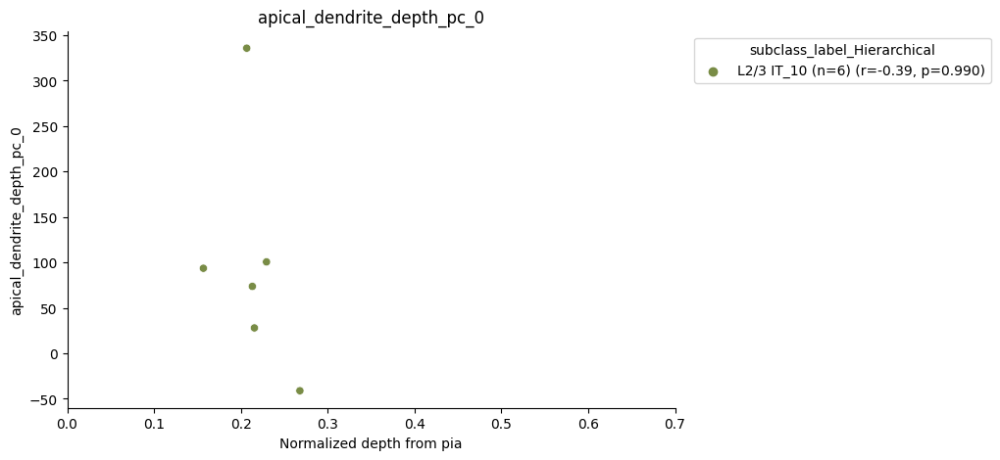

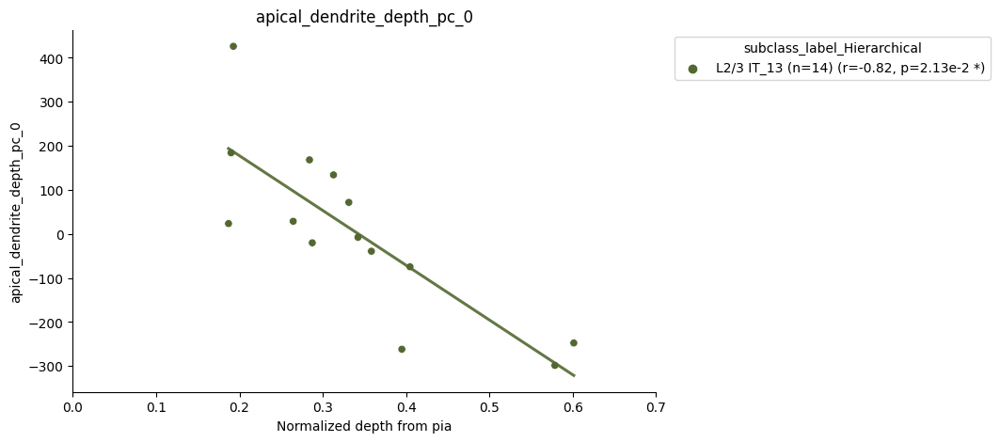

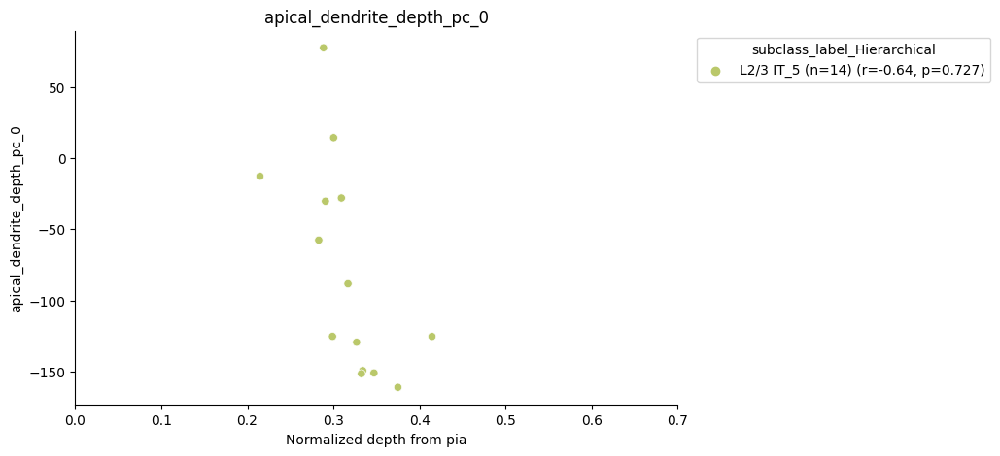

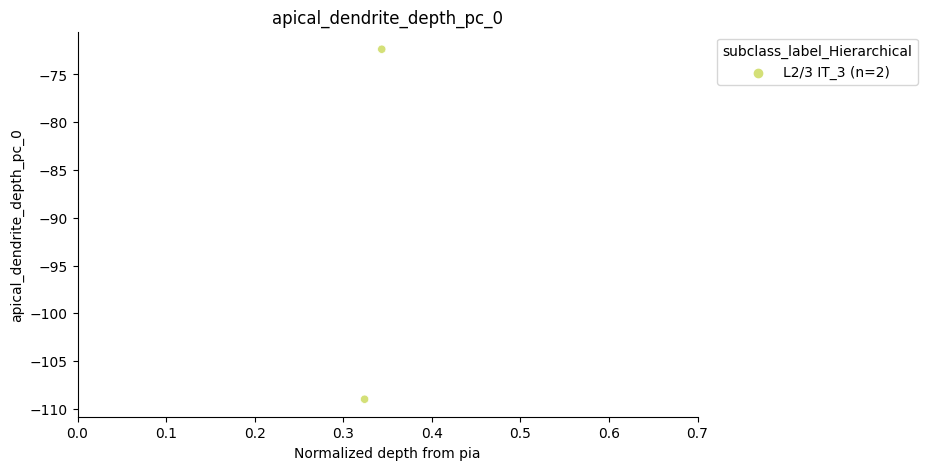

In [31]:
# Supertype level plots

depth_column = 'depth_from_pia_norm'


modality = 'morpho'
feat = 'apical_dendrite_max_euclidean_distance'
feat = 'apical_dendrite_depth_pc_0'
    
if modality == 'morpho':
    feature_cols = m_features
    data = m_data
elif modality == 'ephys':
    feature_cols = e_features
    data = e_data
else:
    raise ValueError(f'Unknown modality: {modality}')

stats_df = supertype_stats[modality]['L2/3 IT']
data = data[data.layer.isin(['Layer 2', 'Layer 3'])]

fig_path = os.path.join(out_dir, 'human_excitatory_depth_vs_{}_scatter_L2_L3_supertype_stats.pdf'.format(feat))
with PdfPages(fig_path) as pdf:
    with warnings.catch_warnings():
        warnings.simplefilter(action='ignore', category=FutureWarning)

        supertypes = [t for t in ttype_order if t in data[cluster_col].unique()]

        for supertype in supertypes:
    
            fig, ax = plt.subplots(figsize=(8, 5))
            
            sns.scatterplot( data=data[data[cluster_col] == supertype], x=depth_column, y=feat, hue=cluster_col, palette=color_dict, ax=ax)
            sns.move_legend(ax, "upper left", bbox_to_anchor=(1.02, 1))

            legend_label = f'{supertype} (n={len(data[(data[cluster_col] == supertype)][[depth_column, feat]].dropna())})'

            for _, row in stats_df[(stats_df['feature'] == feat) & (stats_df['supertype'] == supertype)].iterrows():
                supertype = row['supertype']
                intercept, slope = row['intercept'], row['slope']
                r = row['r']
                pval_fdr = row['pval_fdr']
                p_val_exp = int(np.floor(np.log10(pval_fdr)))  # Exponent of the p-value - for legend
                p_val_mant = pval_fdr / 10**p_val_exp  # Mantissa of the p-value - for legend

                # Get the original data points for this supertype
                data_points = data[(data[cluster_col] == supertype)][[depth_column, feat]].dropna()
                n_cells = len(data_points)
                if n_cells < 3:
                    continue


                if pval_fdr < 0.05: 
                    # Predict the regression line
                    x_vals = np.linspace(data_points[depth_column].min(),
                                        data_points[depth_column].max(), 100)
                    y_vals = intercept + slope * x_vals

                    # Use the same color as the subclass
                    color = color_dict.get(supertype, 'black')
                    ax.plot(x_vals, y_vals, color=color, lw=2.2, alpha=0.9)


                    legend_label += f" (r={r:.2f}, p={p_val_mant:.2f}e{p_val_exp} *)"
                else:
                    legend_label += f" (r={r:.2f}, p={pval_fdr:.3f})"



            # Update legend labels
            handles, labels = ax.get_legend_handles_labels()
            ax.legend(handles, [legend_label], title=subclass_col, bbox_to_anchor=(1.02, 1), loc='upper left')

            ax.set_title(f'{feat}')
            ax.set_xlabel('Normalized depth from pia')
            ax.set_ylabel(feat)
            ax.set_xlim((0, 0.7))
            sns.despine()
            pdf.savefig(fig, bbox_inches='tight')
            plt.show()
            # plt.close(fig)  # Close the figure to release memory